In [33]:
# %%
# %% [markdown]
# ## 1. Chargement des Bibliothèques
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, Model, callbacks
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import cv2
import os
import pandas as pd
from sklearn.model_selection import StratifiedKFold
from tqdm import tqdm
from IPython.display import display
from math import ceil

# Reproductibilité
SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)


In [34]:
# %%
# %% [markdown]
# ## 2. Paramètres et Configuration
IMG_SIZE = (256, 256) 
BATCH_SIZE = 16  # Augmenté pour mieux exploiter les nouvelles données
EPOCHS = 100
VAL_SPLIT = 0.15
TEST_SPLIT = 0.15
DATA_PATH = '/home/kevin/datasets/livrable2/processed_dataaug'
METADATA_PATH = os.path.join(DATA_PATH, 'metadata.csv')

NOISE_CONFIG = {
    'gaussian': {
        'mean': 0.08,      # Variance moyenne typique
        'std': 0.03,       # Écart-type pour la variance
        'clip': (0, 0.3)   # Plage de valeurs valides
    },
    'salt_pepper': {
        'mean': 0.04,      # Densité moyenne typique
        'std': 0.015,
        'clip': (0, 0.2)
    },
    'poisson': {},         # Bruit inhérent au capteur
    'speckle': {
        'mean': 0.12,
        'std': 0.05,
        'clip': (0, 0.4)
    }
}

In [35]:
# %%
# %% [markdown]
# ## 3. Chargement des Données avec Métadonnées (Nouvelle Version)

def data_generator(image_paths, clean_paths, batch_size=32):
    while True:
        indices = np.random.permutation(len(image_paths))
        for i in range(0, len(indices), batch_size):
            batch_paths = indices[i:i+batch_size]
            noisy_batch = []
            clean_batch = []
            for idx in batch_paths:
                # Chargement, forçage couleur et resize
                noisy = cv2.imread(image_paths[idx], cv2.IMREAD_COLOR)
                clean = cv2.imread(clean_paths[idx], cv2.IMREAD_COLOR)
                if noisy is None:
                    noisy = np.zeros((*IMG_SIZE, 3), dtype=np.float32)
                else:
                    noisy = cv2.resize(noisy, IMG_SIZE)
                    noisy = noisy / 255.0
                if clean is None:
                    clean = np.zeros((*IMG_SIZE, 3), dtype=np.float32)
                else:
                    clean = cv2.resize(clean, IMG_SIZE)
                    clean = clean / 255.0
                # Augmentation aléatoire
                if np.random.rand() > 0.5:
                    noisy = cv2.flip(noisy, 1)
                    clean = cv2.flip(clean, 1)
                if np.random.rand() > 0.5:
                    angle = np.random.randint(-15, 15)
                    M = cv2.getRotationMatrix2D((IMG_SIZE[0]//2, IMG_SIZE[1]//2), angle, 1)
                    noisy = cv2.warpAffine(noisy, M, IMG_SIZE)
                    clean = cv2.warpAffine(clean, M, IMG_SIZE)
                noisy_batch.append(noisy)
                clean_batch.append(clean)
            yield np.stack(noisy_batch), np.stack(clean_batch)

def prepare_generators(data_path, metadata_path, test_size=0.2, val_size=0.2, batch_size=32):
    # Charger les métadonnées
    metadata = pd.read_csv(metadata_path)
    
    # Créer les listes de chemins complets
    image_paths = [os.path.join(data_path, 'noisy', f) for f in metadata['noisy']]
    clean_paths = [os.path.join(data_path, 'clean', f) for f in metadata['original']]
    
    # Split initial train/test
    train_paths, test_paths, train_clean, test_clean = train_test_split(
        image_paths, clean_paths, 
        test_size=test_size, 
        random_state=SEED
    )
    
    # Split train/val
    train_paths, val_paths, train_clean, val_clean = train_test_split(
        train_paths, train_clean,
        test_size=val_size,
        random_state=SEED
    )
    
    return {
        'train': data_generator(train_paths, train_clean, BATCH_SIZE),
        'val': data_generator(val_paths, val_clean, BATCH_SIZE),
        'test': (
            np.array([
                cv2.resize(cv2.imread(p, cv2.IMREAD_COLOR), IMG_SIZE)/255.0
                if cv2.imread(p, cv2.IMREAD_COLOR) is not None else np.zeros((*IMG_SIZE, 3))
                for p in test_paths
            ]),
            np.array([
                cv2.resize(cv2.imread(p, cv2.IMREAD_COLOR), IMG_SIZE)/255.0
                if cv2.imread(p, cv2.IMREAD_COLOR) is not None else np.zeros((*IMG_SIZE, 3))
                for p in test_clean
            ])
        ),
        'steps': {
            'train': len(train_paths) // BATCH_SIZE,
            'val': len(val_paths) // BATCH_SIZE
        }
    }

# Chargement avec métadonnées
try:
    data = prepare_generators(DATA_PATH, METADATA_PATH, test_size=TEST_SPLIT, val_size=VAL_SPLIT, batch_size=BATCH_SIZE)
except Exception as e:
    print(f"Erreur: {e}")
    raise

# Accès aux données
train_gen = data['train']
val_gen = data['val']
(X_noisy, X_clean) = data['test']
steps = data['steps']


In [36]:
# %%
# %% [markdown]
# ## 4. Data Augmentation en Temps Réel

# data_augmentation = tf.keras.Sequential([
#     layers.RandomFlip("horizontal_and_vertical"),
#     layers.RandomRotation(0.2),
#     layers.RandomZoom(0.1),
#     layers.RandomContrast(0.1)
# ])

# def preprocess_data(image, label):
#     # Application de l'augmentation seulement sur l'image d'entrée
#     augmented_image = data_augmentation(image)
#     return augmented_image, label

# # Création des datasets avec augmentation
# train_dataset = tf.data.Dataset.from_tensor_slices((X_train, y_train))
# train_dataset = train_dataset.shuffle(buffer_size=1024, reshuffle_each_iteration=True)
# train_dataset = train_dataset.map(preprocess_data, num_parallel_calls=tf.data.AUTOTUNE)
# train_dataset = train_dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

# val_dataset = tf.data.Dataset.from_tensor_slices((X_val, y_val))
# val_dataset = val_dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

In [37]:
# %%
# %% [markdown]
# ## 5. Architecture du Modèle (Améliorée)

class SpatialAttention(layers.Layer):
    def __init__(self, ratio=8, **kwargs):
        super().__init__(**kwargs)
        self.ratio = ratio
        self.dense1 = layers.Dense(1, activation='sigmoid')

    def build(self, input_shape):
        self.conv = layers.Conv2D(1, 7, padding='same', activation='sigmoid')
        super().build(input_shape)

    def call(self, x):
        # Attention spatiale
        max_pool = tf.reduce_max(x, axis=-1, keepdims=True)
        avg_pool = tf.reduce_mean(x, axis=-1, keepdims=True)
        concat = layers.Concatenate()([max_pool, avg_pool])
        attention = self.conv(concat)
        return x * attention

def residual_block(x, filters, use_attention=False):
    # Project shortcut if input channels do not match output filters
    shortcut = x
    if x.shape[-1] != filters:
        shortcut = layers.Conv2D(filters, 1, padding='same')(shortcut)
    x = layers.Conv2D(filters, 3, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.Conv2D(filters, 3, padding='same')(x)
    x = layers.BatchNormalization()(x)
    
    if use_attention:
        x = SpatialAttention()(x)
    
    x = layers.Add()([shortcut, x])
    return layers.Activation('relu')(x)

def multi_scale_unet(input_shape=(256,256,3)):
    inputs = layers.Input(input_shape)
    
    # Encoder multi-échelle
    e1 = residual_block(inputs, 64)
    p1 = layers.MaxPooling2D()(e1)
    
    e2 = residual_block(p1, 128, use_attention=True)
    p2 = layers.MaxPooling2D()(e2)
    
    e3 = residual_block(p2, 256, use_attention=True)
    p3 = layers.MaxPooling2D()(e3)
    
    # Bridge
    bridge = residual_block(p3, 512, use_attention=True)
    bridge = layers.Dropout(0.4)(bridge)
    
    # Decoder avec connexions denses
    d3 = layers.UpSampling2D()(bridge)
    d3 = layers.Concatenate()([d3, e3])
    d3 = residual_block(d3, 256)
    
    d2 = layers.UpSampling2D()(d3)
    d2 = layers.Concatenate()([d2, e2])
    d2 = residual_block(d2, 128)
    
    d1 = layers.UpSampling2D()(d2)
    d1 = layers.Concatenate()([d1, e1])
    d1 = residual_block(d1, 64)
    
    outputs = layers.Conv2D(3, 1, activation='sigmoid')(d1)
    
    return Model(inputs, outputs)

In [38]:
# 1. Définition des métriques de base
def PSNR(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    return tf.image.psnr(y_true, y_pred, max_val=1.0)

def SSIM(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    return tf.image.ssim(y_true, y_pred, max_val=1.0)

# 2. Métrique hybride personnalisée
class HybridPSNRSSIM(tf.keras.metrics.Metric):
    def __init__(self, name='hybrid_psnr_ssim', **kwargs):
        super().__init__(name=name, **kwargs)
        self.psnr = tf.keras.metrics.Mean(name='psnr')
        self.ssim = tf.keras.metrics.Mean(name='ssim')
        
    def update_state(self, y_true, y_pred, sample_weight=None):
        y_true = tf.cast(y_true, tf.float32)
        y_pred = tf.cast(y_pred, tf.float32)
        self.psnr.update_state(tf.image.psnr(y_true, y_pred, 1.0))
        self.ssim.update_state(tf.image.ssim(y_true, y_pred, 1.0))
        
    def result(self):
        return (self.psnr.result() + self.ssim.result())/2
    
    def reset_states(self):
        self.psnr.reset_states()
        self.ssim.reset_states()

# 3. Perte hybride avancée avec intégration VGG
# Initialisation du modèle VGG16 (à placer avant la fonction de perte)
vgg = tf.keras.applications.VGG16(
    include_top=False,
    weights='imagenet',
    input_shape=(256, 256, 3)
)
vgg.trainable = False

def hybrid_loss(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    # Calcul des différentes composantes de la perte
    ssim_loss = 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))
    mse_loss = tf.reduce_mean(tf.square(y_true - y_pred))

    # Pré-traitement pour VGG16 (mise à l'échelle [0,255])
    y_true_scaled = y_true * 255.0
    y_pred_scaled = y_pred * 255.0

    # Extraction des caractéristiques
    y_true_features = vgg(tf.keras.applications.vgg16.preprocess_input(y_true_scaled))
    y_pred_features = vgg(tf.keras.applications.vgg16.preprocess_input(y_pred_scaled))

    # Perte perceptuelle
    perceptual_loss = tf.reduce_mean(tf.square(y_true_features - y_pred_features))

    # Combinaison pondérée
    return 0.6 * ssim_loss + 0.3 * mse_loss + 0.1 * perceptual_loss

In [39]:
# %%
# %% [markdown]
# ## 6. Stratégie d'Entraînement Avancée

class NoiseAdaptiveLoss(tf.keras.losses.Loss):
    def __init__(self, noise_info, **kwargs):
        super().__init__(**kwargs)
        self.noise_levels = np.array([info[1] or 0 for info in noise_info])
        self.loss_fn = tf.keras.losses.MeanSquaredError(reduction=tf.keras.losses.Reduction.NONE)
        
    def __call__(self, y_true, y_pred, sample_weight=None):
        loss = self.loss_fn(y_true, y_pred)
        # Pondération en fonction du niveau de bruit
        weighted_loss = loss * (1 + tf.cast(self.noise_levels, tf.float32))
        return tf.reduce_mean(weighted_loss)
    
# Callback personnalisé pour le monitoring des métriques par type de bruit
class NoiseTypeMonitor(callbacks.Callback):
    def __init__(self, X_val, y_val, noise_info):
        super().__init__()
        self.X_val = X_val
        self.y_val = y_val
        self.noise_info = noise_info

    def on_epoch_end(self, epoch, logs=None):
        # Évaluation par type de bruit
        for noise_type in NOISE_CONFIG.keys():
            idx = [i for i, info in enumerate(self.noise_info) if info[0] == noise_type]
            if len(idx) > 0:
                X_sub = self.X_val[idx]
                y_sub = self.y_val[idx]
                results = self.model.evaluate(X_sub, y_sub, verbose=0)
                logs[f'val_{noise_type}_loss'] = results[0]
                logs[f'val_{noise_type}_psnr'] = results[1]
                logs[f'val_{noise_type}_ssim'] = results[2]

# Charger les métadonnées
metadata = pd.read_csv(METADATA_PATH)

# Récupérer les chemins de validation
val_indices = list(range(steps['train'] * BATCH_SIZE, (steps['train'] + steps['val']) * BATCH_SIZE))
val_metadata = metadata.iloc[val_indices]

# Générer X_val, y_val et noise_info
X_val = []
y_val = []
noise_info = []
for _, row in val_metadata.iterrows():
    noisy_path = os.path.join(DATA_PATH, 'noisy', row['noisy'])
    clean_path = os.path.join(DATA_PATH, 'clean', row['original'])
    noisy_img = cv2.imread(noisy_path, cv2.IMREAD_COLOR)    
    clean_img = cv2.imread(clean_path, cv2.IMREAD_COLOR)
    if noisy_img is not None and clean_img is not None:
        noisy_img = cv2.resize(noisy_img, IMG_SIZE) / 255.0
        clean_img = cv2.resize(clean_img, IMG_SIZE) / 255.0
        X_val.append(noisy_img)
        y_val.append(clean_img)
        # Suppose que le type de bruit et le niveau sont dans les colonnes 'noise_type' et 'noise_level'
        noise_info.append((row.get('noise_type', 'unknown'), row.get('noise_level', 0)))
X_val = np.array(X_val)
y_val = np.array(y_val)

# Optimiseur avec gradient clipping
# Optimiseur avec gradient clipping
optimizer = tf.keras.optimizers.AdamW(
    learning_rate=1e-3,
    weight_decay=1e-4,
    global_clipnorm=1.0
)

# Compilation
model = multi_scale_unet(input_shape=(256, 256, 3))
model.compile(
    optimizer=optimizer,
    loss=hybrid_loss,  # Utilisation de la perte hybride
    metrics=[
        PSNR,          # Métrique PSNR standard
        SSIM,          # Métrique SSIM standard
        HybridPSNRSSIM() # Métrique hybride personnalisée
    ]
)
# Définition des callbacks
early_stop = callbacks.EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True
)
checkpoint = callbacks.ModelCheckpoint(
    "best_model.h5",
    monitor="val_loss",
    save_best_only=True,
    verbose=1
)
tensorboard = callbacks.TensorBoard(
    log_dir="logs/fit/" + pd.Timestamp.now().strftime("%Y%m%d-%H%M%S"),
    histogram_freq=1
)


In [49]:

# Entraînement du modèle
history = model.fit(
    train_gen,
    steps_per_epoch=steps['train'],
    validation_data=val_gen,
    validation_steps=steps['val'],
    epochs=EPOCHS,
    callbacks=[early_stop, checkpoint, tensorboard, NoiseTypeMonitor(X_val, y_val, noise_info)],
    verbose=1
)

Epoch 1/100


2025-04-16 13:08:35.177398: E external/local_xla/xla/service/slow_operation_alarm.cc:73] Trying algorithm eng0{} for conv %cudnn-conv-bw-input.43 = (f32[16,192,256,256]{3,2,1,0}, u8[0]{0}) custom-call(f32[16,64,256,256]{3,2,1,0} %bitcast.29351, f32[64,192,3,3]{3,2,1,0} %bitcast.33259), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardInput", metadata={op_type="Conv2DBackpropInput" op_name="gradient_tape/functional_7_1/conv2d_199_1/convolution/Conv2DBackpropInput" source_file="/home/kevin/dev/tf217/tf217/lib/python3.12/site-packages/tensorflow/python/framework/ops.py" source_line=1200}, backend_config={"operation_queue_id":"0","wait_on_operation_queues":[],"cudnn_conv_backend_config":{"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0},"force_earliest_schedule":false} is taking a while...
2025-04-16 13:08:35.255360: E external/local_xla/xla/service/slow_operation_alarm.cc:140] The operation took 1.07

106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step - hybrid_psnr_ssim: 9.5226 - loss: 6.3131 - psnr: 18.5346 - ssim: 0.5105
Epoch 1: val_loss improved from inf to 7.83906, saving model to best_model.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 245s 2s/step - hybrid_psnr_ssim: 9.5388 - loss: 6.2971 - psnr: 18.5658 - ssim: 0.5118 - val_hybrid_psnr_ssim: 6.7393 - val_loss: 7.8391 - val_psnr: 13.0050 - val_ssim: 0.4737 - val_gaussian_loss: 9.8966 - val_gaussian_psnr: 13.2034 - val_gaussian_ssim: 0.4377 - val_salt_pepper_loss: 9.2087 - val_salt_pepper_psnr: 13.3770 - val_salt_pepper_ssim: 0.4592 - val_poisson_loss: 8.5233 - val_poisson_psnr: 13.5352 - val_poisson_ssim: 0.4777 - val_speckle_loss: 8.6152 - val_speckle_psnr: 13.5231 - val_speckle_ssim: 0.4749
Epoch 2/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step - hybrid_psnr_ssim: 12.3736 - loss: 3.3967 - psnr: 24.0097 - ssim: 0.7375
Epoch 2: val_loss improved from 7.83906 to 6.74834, saving model to best_model.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 128s 651ms/step - hybrid_psnr_ssim: 12.3749 - loss: 3.3952 - psnr: 24.0121 - ssim: 0.7376 - val_hybrid_psnr_ssim: 7.2849 - val_loss: 6.7483 - val_psnr: 14.0436 - val_ssim: 0.5262 - val_gaussian_loss: 9.2294 - val_gaussian_psnr: 14.0654 - val_gaussian_ssim: 0.4741 - val_salt_pepper_loss: 8.1152 - val_salt_pepper_psnr: 14.3454 - val_salt_pepper_ssim: 0.5146 - val_poisson_loss: 6.8928 - val_poisson_psnr: 14.6159 - val_poisson_ssim: 0.5554 - val_speckle_loss: 7.0444 - val_speckle_psnr: 14.5925 - val_speckle_ssim: 0.5481
Epoch 3/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 503ms/step - hybrid_psnr_ssim: 12.7500 - loss: 2.9161 - psnr: 24.7292 - ssim: 0.7707
Epoch 3: val_loss improved from 6.74834 to 5.49774, saving model to best_model.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 75s 707ms/step - hybrid_psnr_ssim: 12.7506 - loss: 2.9159 - psnr: 24.7304 - ssim: 0.7707 - val_hybrid_psnr_ssim: 8.3084 - val_loss: 5.4977 - val_psnr: 15.9867 - val_ssim: 0.6300 - val_gaussian_loss: 8.1795 - val_gaussian_psnr: 15.6627 - val_gaussian_ssim: 0.5451 - val_salt_pepper_loss: 6.3347 - val_salt_pepper_psnr: 16.2610 - val_salt_pepper_ssim: 0.6291 - val_poisson_loss: 4.5234 - val_poisson_psnr: 16.8016 - val_poisson_ssim: 0.7026 - val_speckle_loss: 4.7876 - val_speckle_psnr: 16.7002 - val_speckle_ssim: 0.6872
Epoch 4/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step - hybrid_psnr_ssim: 13.0156 - loss: 2.7860 - psnr: 25.2492 - ssim: 0.7819
Epoch 4: val_loss improved from 5.49774 to 4.41731, saving model to best_model.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 65s 618ms/step - hybrid_psnr_ssim: 13.0160 - loss: 2.7853 - psnr: 25.2500 - ssim: 0.7820 - val_hybrid_psnr_ssim: 9.9437 - val_loss: 4.4173 - val_psnr: 19.1938 - val_ssim: 0.6935 - val_gaussian_loss: 7.4481 - val_gaussian_psnr: 18.2100 - val_gaussian_ssim: 0.5485 - val_salt_pepper_loss: 4.8194 - val_salt_pepper_psnr: 19.5461 - val_salt_pepper_ssim: 0.6940 - val_poisson_loss: 2.4841 - val_poisson_psnr: 20.5202 - val_poisson_ssim: 0.8360 - val_speckle_loss: 3.0054 - val_speckle_psnr: 20.3318 - val_speckle_ssim: 0.7929
Epoch 5/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step - hybrid_psnr_ssim: 13.0478 - loss: 2.6130 - psnr: 25.3029 - ssim: 0.7927
Epoch 5: val_loss improved from 4.41731 to 3.65659, saving model to best_model.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 70s 663ms/step - hybrid_psnr_ssim: 13.0481 - loss: 2.6127 - psnr: 25.3035 - ssim: 0.7927 - val_hybrid_psnr_ssim: 11.4973 - val_loss: 3.6566 - val_psnr: 22.2511 - val_ssim: 0.7435 - val_gaussian_loss: 6.4490 - val_gaussian_psnr: 20.3802 - val_gaussian_ssim: 0.6161 - val_salt_pepper_loss: 3.5287 - val_salt_pepper_psnr: 22.6156 - val_salt_pepper_ssim: 0.7692 - val_poisson_loss: 1.7744 - val_poisson_psnr: 24.4971 - val_poisson_ssim: 0.8790 - val_speckle_loss: 2.1158 - val_speckle_psnr: 23.9408 - val_speckle_ssim: 0.8506
Epoch 6/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step - hybrid_psnr_ssim: 13.2919 - loss: 2.5681 - psnr: 25.7877 - ssim: 0.7961
Epoch 6: val_loss improved from 3.65659 to 3.31072, saving model to best_model.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 65s 617ms/step - hybrid_psnr_ssim: 13.2910 - loss: 2.5676 - psnr: 25.7858 - ssim: 0.7962 - val_hybrid_psnr_ssim: 13.2932 - val_loss: 3.3107 - val_psnr: 25.8379 - val_ssim: 0.7485 - val_gaussian_loss: 6.4273 - val_gaussian_psnr: 22.0702 - val_gaussian_ssim: 0.5781 - val_salt_pepper_loss: 2.9062 - val_salt_pepper_psnr: 25.7968 - val_salt_pepper_ssim: 0.7716 - val_poisson_loss: 0.5636 - val_poisson_psnr: 29.6340 - val_poisson_ssim: 0.9576 - val_speckle_loss: 1.3074 - val_speckle_psnr: 28.2375 - val_speckle_ssim: 0.8649
Epoch 7/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step - hybrid_psnr_ssim: 13.3662 - loss: 2.3888 - psnr: 25.9299 - ssim: 0.8025
Epoch 7: val_loss improved from 3.31072 to 2.85963, saving model to best_model.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 64s 608ms/step - hybrid_psnr_ssim: 13.3659 - loss: 2.3887 - psnr: 25.9292 - ssim: 0.8025 - val_hybrid_psnr_ssim: 13.8261 - val_loss: 2.8596 - val_psnr: 26.8680 - val_ssim: 0.7843 - val_gaussian_loss: 5.8946 - val_gaussian_psnr: 23.2951 - val_gaussian_ssim: 0.6173 - val_salt_pepper_loss: 2.2230 - val_salt_pepper_psnr: 27.2862 - val_salt_pepper_ssim: 0.8148 - val_poisson_loss: 0.5074 - val_poisson_psnr: 31.0244 - val_poisson_ssim: 0.9520 - val_speckle_loss: 1.0005 - val_speckle_psnr: 29.5166 - val_speckle_ssim: 0.8965
Epoch 8/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step - hybrid_psnr_ssim: 13.1375 - loss: 2.4475 - psnr: 25.4754 - ssim: 0.7996
Epoch 8: val_loss improved from 2.85963 to 2.55354, saving model to best_model.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 65s 617ms/step - hybrid_psnr_ssim: 13.1384 - loss: 2.4469 - psnr: 25.4771 - ssim: 0.7996 - val_hybrid_psnr_ssim: 14.0679 - val_loss: 2.5535 - val_psnr: 27.3344 - val_ssim: 0.8014 - val_gaussian_loss: 5.7036 - val_gaussian_psnr: 23.2161 - val_gaussian_ssim: 0.6244 - val_salt_pepper_loss: 2.3763 - val_salt_pepper_psnr: 27.0805 - val_salt_pepper_ssim: 0.8147 - val_poisson_loss: 0.5433 - val_poisson_psnr: 31.2591 - val_poisson_ssim: 0.9585 - val_speckle_loss: 1.0420 - val_speckle_psnr: 29.9874 - val_speckle_ssim: 0.9070
Epoch 9/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step - hybrid_psnr_ssim: 13.0796 - loss: 2.3540 - psnr: 25.3559 - ssim: 0.8033
Epoch 9: val_loss did not improve from 2.55354
106/106 ━━━━━━━━━━━━━━━━━━━━ 64s 607ms/step - hybrid_psnr_ssim: 13.0810 - loss: 2.3535 - psnr: 25.3587 - ssim: 0.8033 - val_hybrid_psnr_ssim: 11.4313 - val_loss: 5.1114 - val_psnr: 22.1476 - val_ssim: 0.7150 - val_gaussian_loss: 7.5381 - val_gaussian_psnr: 20.6681 - val_ga

106/106 ━━━━━━━━━━━━━━━━━━━━ 66s 621ms/step - hybrid_psnr_ssim: 13.6493 - loss: 2.2102 - psnr: 26.4828 - ssim: 0.8159 - val_hybrid_psnr_ssim: 14.5948 - val_loss: 2.4925 - val_psnr: 28.3829 - val_ssim: 0.8066 - val_gaussian_loss: 5.4341 - val_gaussian_psnr: 23.9587 - val_gaussian_ssim: 0.6459 - val_salt_pepper_loss: 1.9046 - val_salt_pepper_psnr: 28.3812 - val_salt_pepper_ssim: 0.8336 - val_poisson_loss: 0.4441 - val_poisson_psnr: 33.3721 - val_poisson_ssim: 0.9604 - val_speckle_loss: 0.9129 - val_speckle_psnr: 30.9572 - val_speckle_ssim: 0.9118
Epoch 11/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step - hybrid_psnr_ssim: 13.4039 - loss: 2.2603 - psnr: 25.9982 - ssim: 0.8096
Epoch 11: val_loss did not improve from 2.49250
106/106 ━━━━━━━━━━━━━━━━━━━━ 62s 585ms/step - hybrid_psnr_ssim: 13.4046 - loss: 2.2600 - psnr: 25.9997 - ssim: 0.8096 - val_hybrid_psnr_ssim: 14.0913 - val_loss: 2.6206 - val_psnr: 27.3875 - val_ssim: 0.7951 - val_gaussian_loss: 5.9222 - val_gaussian_psnr: 23.2192 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 65s 619ms/step - hybrid_psnr_ssim: 13.6183 - loss: 1.9758 - psnr: 26.4093 - ssim: 0.8273 - val_hybrid_psnr_ssim: 15.0328 - val_loss: 2.2124 - val_psnr: 29.2312 - val_ssim: 0.8344 - val_gaussian_loss: 5.2147 - val_gaussian_psnr: 24.3828 - val_gaussian_ssim: 0.6735 - val_salt_pepper_loss: 1.6797 - val_salt_pepper_psnr: 28.9213 - val_salt_pepper_ssim: 0.8565 - val_poisson_loss: 0.3637 - val_poisson_psnr: 33.7839 - val_poisson_ssim: 0.9693 - val_speckle_loss: 0.8589 - val_speckle_psnr: 31.5531 - val_speckle_ssim: 0.9192
Epoch 18/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step - hybrid_psnr_ssim: 13.6821 - loss: 2.0026 - psnr: 26.5421 - ssim: 0.8220
Epoch 18: val_loss did not improve from 2.21244
106/106 ━━━━━━━━━━━━━━━━━━━━ 62s 588ms/step - hybrid_psnr_ssim: 13.6825 - loss: 2.0022 - psnr: 26.5430 - ssim: 0.8220 - val_hybrid_psnr_ssim: 13.5917 - val_loss: 2.6587 - val_psnr: 26.3625 - val_ssim: 0.8209 - val_gaussian_loss: 4.9658 - val_gaussian_psnr: 23.8264 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 65s 613ms/step - hybrid_psnr_ssim: 13.6706 - loss: 1.8349 - psnr: 26.5119 - ssim: 0.8292 - val_hybrid_psnr_ssim: 14.4001 - val_loss: 2.1488 - val_psnr: 27.9697 - val_ssim: 0.8305 - val_gaussian_loss: 4.5687 - val_gaussian_psnr: 23.9160 - val_gaussian_ssim: 0.6832 - val_salt_pepper_loss: 1.5175 - val_salt_pepper_psnr: 28.2262 - val_salt_pepper_ssim: 0.8625 - val_poisson_loss: 0.3941 - val_poisson_psnr: 31.7686 - val_poisson_ssim: 0.9713 - val_speckle_loss: 0.8833 - val_speckle_psnr: 30.0386 - val_speckle_ssim: 0.9131
Epoch 23/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step - hybrid_psnr_ssim: 13.7186 - loss: 1.7583 - psnr: 26.6045 - ssim: 0.8327
Epoch 23: val_loss improved from 2.14875 to 2.02546, saving model to best_model.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 64s 604ms/step - hybrid_psnr_ssim: 13.7193 - loss: 1.7579 - psnr: 26.6059 - ssim: 0.8327 - val_hybrid_psnr_ssim: 14.3652 - val_loss: 2.0255 - val_psnr: 27.9005 - val_ssim: 0.8299 - val_gaussian_loss: 4.3725 - val_gaussian_psnr: 23.4969 - val_gaussian_ssim: 0.6786 - val_salt_pepper_loss: 1.2380 - val_salt_pepper_psnr: 28.3022 - val_salt_pepper_ssim: 0.8658 - val_poisson_loss: 0.3019 - val_poisson_psnr: 33.1568 - val_poisson_ssim: 0.9716 - val_speckle_loss: 0.7006 - val_speckle_psnr: 30.3674 - val_speckle_ssim: 0.9197
Epoch 24/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step - hybrid_psnr_ssim: 13.8824 - loss: 1.8099 - psnr: 26.9349 - ssim: 0.8299
Epoch 24: val_loss did not improve from 2.02546
106/106 ━━━━━━━━━━━━━━━━━━━━ 65s 610ms/step - hybrid_psnr_ssim: 13.8824 - loss: 1.8096 - psnr: 26.9348 - ssim: 0.8299 - val_hybrid_psnr_ssim: 13.8053 - val_loss: 2.1494 - val_psnr: 26.7736 - val_ssim: 0.8370 - val_gaussian_loss: 4.5250 - val_gaussian_psnr: 23.2134 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 68s 645ms/step - hybrid_psnr_ssim: 14.0505 - loss: 1.5770 - psnr: 27.2554 - ssim: 0.8456 - val_hybrid_psnr_ssim: 14.8207 - val_loss: 2.0188 - val_psnr: 28.8211 - val_ssim: 0.8204 - val_gaussian_loss: 4.0660 - val_gaussian_psnr: 24.2153 - val_gaussian_ssim: 0.6731 - val_salt_pepper_loss: 1.1242 - val_salt_pepper_psnr: 29.4150 - val_salt_pepper_ssim: 0.8623 - val_poisson_loss: 0.1766 - val_poisson_psnr: 35.1590 - val_poisson_ssim: 0.9779 - val_speckle_loss: 0.7050 - val_speckle_psnr: 31.7072 - val_speckle_ssim: 0.8992
Epoch 28/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step - hybrid_psnr_ssim: 14.0603 - loss: 1.6693 - psnr: 27.2789 - ssim: 0.8417
Epoch 28: val_loss did not improve from 2.01878
106/106 ━━━━━━━━━━━━━━━━━━━━ 63s 593ms/step - hybrid_psnr_ssim: 14.0602 - loss: 1.6690 - psnr: 27.2787 - ssim: 0.8417 - val_hybrid_psnr_ssim: 14.7755 - val_loss: 2.1645 - val_psnr: 28.7157 - val_ssim: 0.8354 - val_gaussian_loss: 4.3822 - val_gaussian_psnr: 24.3551 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 68s 647ms/step - hybrid_psnr_ssim: 13.8584 - loss: 1.6172 - psnr: 26.8774 - ssim: 0.8394 - val_hybrid_psnr_ssim: 14.6463 - val_loss: 1.9668 - val_psnr: 28.4479 - val_ssim: 0.8448 - val_gaussian_loss: 4.1005 - val_gaussian_psnr: 24.2331 - val_gaussian_ssim: 0.7007 - val_salt_pepper_loss: 1.2687 - val_salt_pepper_psnr: 28.6731 - val_salt_pepper_ssim: 0.8728 - val_poisson_loss: 0.3063 - val_poisson_psnr: 32.6891 - val_poisson_ssim: 0.9752 - val_speckle_loss: 0.7669 - val_speckle_psnr: 30.5908 - val_speckle_ssim: 0.9177
Epoch 31/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 492ms/step - hybrid_psnr_ssim: 14.1709 - loss: 1.4857 - psnr: 27.4952 - ssim: 0.8467
Epoch 31: val_loss improved from 1.96677 to 1.96451, saving model to best_model.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 69s 649ms/step - hybrid_psnr_ssim: 14.1701 - loss: 1.4859 - psnr: 27.4935 - ssim: 0.8467 - val_hybrid_psnr_ssim: 14.5932 - val_loss: 1.9645 - val_psnr: 28.3474 - val_ssim: 0.8389 - val_gaussian_loss: 4.0528 - val_gaussian_psnr: 23.9591 - val_gaussian_ssim: 0.6977 - val_salt_pepper_loss: 1.3466 - val_salt_pepper_psnr: 28.8720 - val_salt_pepper_ssim: 0.8697 - val_poisson_loss: 0.2593 - val_poisson_psnr: 32.7146 - val_poisson_ssim: 0.9715 - val_speckle_loss: 0.8159 - val_speckle_psnr: 31.1155 - val_speckle_ssim: 0.9184
Epoch 32/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step - hybrid_psnr_ssim: 14.1553 - loss: 1.5197 - psnr: 27.4645 - ssim: 0.8460
Epoch 32: val_loss did not improve from 1.96451
106/106 ━━━━━━━━━━━━━━━━━━━━ 65s 611ms/step - hybrid_psnr_ssim: 14.1548 - loss: 1.5197 - psnr: 27.4636 - ssim: 0.8460 - val_hybrid_psnr_ssim: 14.9925 - val_loss: 2.1017 - val_psnr: 29.1651 - val_ssim: 0.8199 - val_gaussian_loss: 4.3174 - val_gaussian_psnr: 24.0727 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 66s 621ms/step - hybrid_psnr_ssim: 14.1225 - loss: 1.5228 - psnr: 27.4005 - ssim: 0.8445 - val_hybrid_psnr_ssim: 15.0009 - val_loss: 1.8425 - val_psnr: 29.1620 - val_ssim: 0.8399 - val_gaussian_loss: 3.8120 - val_gaussian_psnr: 24.5155 - val_gaussian_ssim: 0.6990 - val_salt_pepper_loss: 1.0591 - val_salt_pepper_psnr: 29.7946 - val_salt_pepper_ssim: 0.8772 - val_poisson_loss: 0.1794 - val_poisson_psnr: 34.8749 - val_poisson_ssim: 0.9756 - val_speckle_loss: 0.6343 - val_speckle_psnr: 31.9009 - val_speckle_ssim: 0.9163
Epoch 34/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step - hybrid_psnr_ssim: 14.1675 - loss: 1.4057 - psnr: 27.4807 - ssim: 0.8542
Epoch 34: val_loss improved from 1.84247 to 1.81330, saving model to best_model.h5


106/106 ━━━━━━━━━━━━━━━━━━━━ 65s 611ms/step - hybrid_psnr_ssim: 14.1671 - loss: 1.4061 - psnr: 27.4801 - ssim: 0.8542 - val_hybrid_psnr_ssim: 14.7781 - val_loss: 1.8133 - val_psnr: 28.7051 - val_ssim: 0.8511 - val_gaussian_loss: 3.7833 - val_gaussian_psnr: 24.1781 - val_gaussian_ssim: 0.7074 - val_salt_pepper_loss: 1.0329 - val_salt_pepper_psnr: 29.1006 - val_salt_pepper_ssim: 0.8830 - val_poisson_loss: 0.2028 - val_poisson_psnr: 33.4669 - val_poisson_ssim: 0.9798 - val_speckle_loss: 0.5794 - val_speckle_psnr: 31.1763 - val_speckle_ssim: 0.9241
Epoch 35/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step - hybrid_psnr_ssim: 14.0474 - loss: 1.4650 - psnr: 27.2467 - ssim: 0.8481
Epoch 35: val_loss did not improve from 1.81330
106/106 ━━━━━━━━━━━━━━━━━━━━ 63s 597ms/step - hybrid_psnr_ssim: 14.0485 - loss: 1.4648 - psnr: 27.2489 - ssim: 0.8481 - val_hybrid_psnr_ssim: 15.0605 - val_loss: 2.0200 - val_psnr: 29.2932 - val_ssim: 0.8277 - val_gaussian_loss: 4.1038 - val_gaussian_psnr: 24.3666 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 68s 644ms/step - hybrid_psnr_ssim: 14.1738 - loss: 1.3988 - psnr: 27.4982 - ssim: 0.8494 - val_hybrid_psnr_ssim: 14.3778 - val_loss: 1.6283 - val_psnr: 27.8944 - val_ssim: 0.8612 - val_gaussian_loss: 3.5526 - val_gaussian_psnr: 23.9620 - val_gaussian_ssim: 0.7181 - val_salt_pepper_loss: 1.0612 - val_salt_pepper_psnr: 27.7340 - val_salt_pepper_ssim: 0.8861 - val_poisson_loss: 0.3553 - val_poisson_psnr: 30.4521 - val_poisson_ssim: 0.9715 - val_speckle_loss: 0.7497 - val_speckle_psnr: 29.0280 - val_speckle_ssim: 0.9220
Epoch 39/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step - hybrid_psnr_ssim: 14.2524 - loss: 1.3879 - psnr: 27.6514 - ssim: 0.8534
Epoch 39: val_loss did not improve from 1.62830
106/106 ━━━━━━━━━━━━━━━━━━━━ 62s 590ms/step - hybrid_psnr_ssim: 14.2520 - loss: 1.3877 - psnr: 27.6506 - ssim: 0.8534 - val_hybrid_psnr_ssim: 15.2867 - val_loss: 1.6938 - val_psnr: 29.7187 - val_ssim: 0.8548 - val_gaussian_loss: 3.5091 - val_gaussian_psnr: 24.6683 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 69s 653ms/step - hybrid_psnr_ssim: 14.5100 - loss: 1.2486 - psnr: 28.1576 - ssim: 0.8623 - val_hybrid_psnr_ssim: 15.1300 - val_loss: 1.4965 - val_psnr: 29.4100 - val_ssim: 0.8500 - val_gaussian_loss: 3.1458 - val_gaussian_psnr: 24.5391 - val_gaussian_ssim: 0.7123 - val_salt_pepper_loss: 0.8255 - val_salt_pepper_psnr: 29.8735 - val_salt_pepper_ssim: 0.8883 - val_poisson_loss: 0.1861 - val_poisson_psnr: 34.8704 - val_poisson_ssim: 0.9748 - val_speckle_loss: 0.5572 - val_speckle_psnr: 31.6571 - val_speckle_ssim: 0.9169
Epoch 46/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step - hybrid_psnr_ssim: 14.4079 - loss: 1.2539 - psnr: 27.9579 - ssim: 0.8580
Epoch 46: val_loss did not improve from 1.49654
106/106 ━━━━━━━━━━━━━━━━━━━━ 66s 626ms/step - hybrid_psnr_ssim: 14.4068 - loss: 1.2541 - psnr: 27.9555 - ssim: 0.8580 - val_hybrid_psnr_ssim: 14.9890 - val_loss: 1.7338 - val_psnr: 29.1224 - val_ssim: 0.8556 - val_gaussian_loss: 3.4907 - val_gaussian_psnr: 24.4524 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 69s 651ms/step - hybrid_psnr_ssim: 14.4729 - loss: 1.2222 - psnr: 28.0811 - ssim: 0.8648 - val_hybrid_psnr_ssim: 15.6000 - val_loss: 1.4842 - val_psnr: 30.3348 - val_ssim: 0.8652 - val_gaussian_loss: 3.1088 - val_gaussian_psnr: 24.8751 - val_gaussian_ssim: 0.7174 - val_salt_pepper_loss: 0.7874 - val_salt_pepper_psnr: 30.4659 - val_salt_pepper_ssim: 0.8985 - val_poisson_loss: 0.1560 - val_poisson_psnr: 36.4998 - val_poisson_ssim: 0.9815 - val_speckle_loss: 0.4811 - val_speckle_psnr: 32.6337 - val_speckle_ssim: 0.9303
Epoch 48/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step - hybrid_psnr_ssim: 14.2184 - loss: 1.2999 - psnr: 27.5833 - ssim: 0.8535
Epoch 48: val_loss did not improve from 1.48422
106/106 ━━━━━━━━━━━━━━━━━━━━ 65s 611ms/step - hybrid_psnr_ssim: 14.2193 - loss: 1.2997 - psnr: 27.5851 - ssim: 0.8535 - val_hybrid_psnr_ssim: 14.4971 - val_loss: 1.8309 - val_psnr: 28.1423 - val_ssim: 0.8520 - val_gaussian_loss: 3.4596 - val_gaussian_psnr: 24.1419 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 64s 605ms/step - hybrid_psnr_ssim: 14.5030 - loss: 1.1788 - psnr: 28.1422 - ssim: 0.8638 - val_hybrid_psnr_ssim: 14.8277 - val_loss: 1.4763 - val_psnr: 28.7873 - val_ssim: 0.8682 - val_gaussian_loss: 3.0124 - val_gaussian_psnr: 24.4754 - val_gaussian_ssim: 0.7245 - val_salt_pepper_loss: 0.7863 - val_salt_pepper_psnr: 29.5937 - val_salt_pepper_ssim: 0.9030 - val_poisson_loss: 0.2237 - val_poisson_psnr: 33.6195 - val_poisson_ssim: 0.9783 - val_speckle_loss: 0.5366 - val_speckle_psnr: 31.3192 - val_speckle_ssim: 0.9295
Epoch 51/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step - hybrid_psnr_ssim: 14.6296 - loss: 1.1698 - psnr: 28.3938 - ssim: 0.8653
Epoch 51: val_loss did not improve from 1.47631
106/106 ━━━━━━━━━━━━━━━━━━━━ 63s 595ms/step - hybrid_psnr_ssim: 14.6285 - loss: 1.1699 - psnr: 28.3916 - ssim: 0.8653 - val_hybrid_psnr_ssim: 15.1503 - val_loss: 1.5765 - val_psnr: 29.4378 - val_ssim: 0.8629 - val_gaussian_loss: 2.8883 - val_gaussian_psnr: 24.8428 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 62s 584ms/step - hybrid_psnr_ssim: 14.3929 - loss: 1.1599 - psnr: 27.9235 - ssim: 0.8623 - val_hybrid_psnr_ssim: 15.4576 - val_loss: 1.4459 - val_psnr: 30.0426 - val_ssim: 0.8727 - val_gaussian_loss: 2.8637 - val_gaussian_psnr: 24.9092 - val_gaussian_ssim: 0.7318 - val_salt_pepper_loss: 0.7641 - val_salt_pepper_psnr: 30.4496 - val_salt_pepper_ssim: 0.9041 - val_poisson_loss: 0.1780 - val_poisson_psnr: 36.1999 - val_poisson_ssim: 0.9842 - val_speckle_loss: 0.4961 - val_speckle_psnr: 32.3338 - val_speckle_ssim: 0.9324
Epoch 54/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step - hybrid_psnr_ssim: 14.6138 - loss: 1.1204 - psnr: 28.3597 - ssim: 0.8678
Epoch 54: val_loss did not improve from 1.44589
106/106 ━━━━━━━━━━━━━━━━━━━━ 62s 582ms/step - hybrid_psnr_ssim: 14.6133 - loss: 1.1202 - psnr: 28.3588 - ssim: 0.8678 - val_hybrid_psnr_ssim: 15.1833 - val_loss: 1.7148 - val_psnr: 29.5039 - val_ssim: 0.8627 - val_gaussian_loss: 3.3019 - val_gaussian_psnr: 24.4236 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 70s 661ms/step - hybrid_psnr_ssim: 14.4383 - loss: 1.1142 - psnr: 28.0105 - ssim: 0.8661 - val_hybrid_psnr_ssim: 15.4291 - val_loss: 1.4342 - val_psnr: 29.9887 - val_ssim: 0.8695 - val_gaussian_loss: 2.6767 - val_gaussian_psnr: 24.9765 - val_gaussian_ssim: 0.7314 - val_salt_pepper_loss: 0.6743 - val_salt_pepper_psnr: 30.7159 - val_salt_pepper_ssim: 0.9061 - val_poisson_loss: 0.1393 - val_poisson_psnr: 36.7835 - val_poisson_ssim: 0.9862 - val_speckle_loss: 0.4377 - val_speckle_psnr: 32.8945 - val_speckle_ssim: 0.9347
Epoch 58/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step - hybrid_psnr_ssim: 14.6247 - loss: 1.1048 - psnr: 28.3802 - ssim: 0.8691
Epoch 58: val_loss did not improve from 1.43423
106/106 ━━━━━━━━━━━━━━━━━━━━ 68s 641ms/step - hybrid_psnr_ssim: 14.6252 - loss: 1.1046 - psnr: 28.3812 - ssim: 0.8691 - val_hybrid_psnr_ssim: 15.5175 - val_loss: 1.4439 - val_psnr: 30.1579 - val_ssim: 0.8771 - val_gaussian_loss: 2.7266 - val_gaussian_psnr: 24.9718 - val_

106/106 ━━━━━━━━━━━━━━━━━━━━ 68s 643ms/step - hybrid_psnr_ssim: 14.6599 - loss: 1.0566 - psnr: 28.4482 - ssim: 0.8717 - val_hybrid_psnr_ssim: 15.2525 - val_loss: 1.3417 - val_psnr: 29.6443 - val_ssim: 0.8607 - val_gaussian_loss: 2.6427 - val_gaussian_psnr: 24.5193 - val_gaussian_ssim: 0.7258 - val_salt_pepper_loss: 0.6763 - val_salt_pepper_psnr: 30.1318 - val_salt_pepper_ssim: 0.9005 - val_poisson_loss: 0.1540 - val_poisson_psnr: 34.7041 - val_poisson_ssim: 0.9750 - val_speckle_loss: 0.4754 - val_speckle_psnr: 31.9381 - val_speckle_ssim: 0.9252
Epoch 61/100
Epoch 61/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 508ms/step - hybrid_psnr_ssim: 14.6874 - loss: 1.0382 - psnr: 28.5024 - ssim: 0.8723
Epoch 61: val_loss did not improve from 1.34173
106/106 ━━━━━━━━━━━━━━━━━━━━ 72s 677ms/step - hybrid_psnr_ssim: 14.6877 - loss: 1.0383 - psnr: 28.5030 - ssim: 0.8723 - val_hybrid_psnr_ssim: 15.6144 - val_loss: 1.4019 - val_psnr: 30.3632 - val_ssim: 0.8656 - val_gaussian_loss: 2.6579 - val_gaussian_psnr: 2

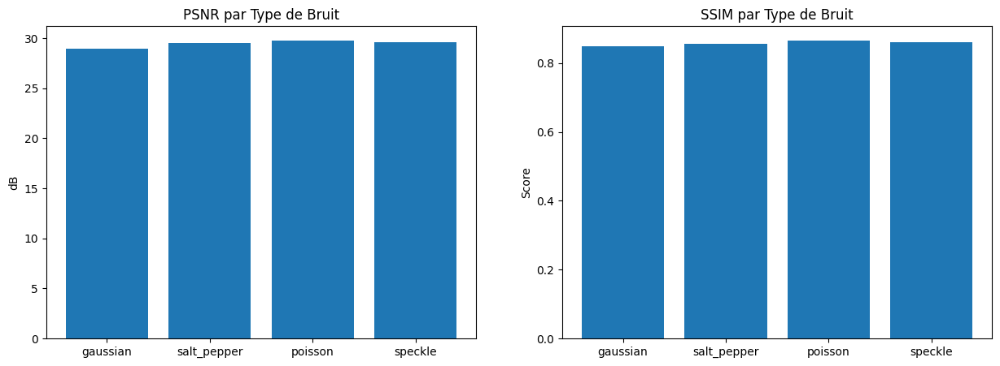

In [52]:
# %%
# %% [markdown]
# ## 8. Évaluation Multi-Critères

import collections

(X_noisy, X_clean) = data['test']

def evaluate_by_noise_type(model, X_test, y_test, noise_info):
    """
    Évalue le modèle pour chaque type de bruit présent dans noise_info.
    """
    results = collections.OrderedDict()
    noise_types = list(NOISE_CONFIG.keys())
    # Regrouper les indices par type de bruit
    noise_indices = {nt: [] for nt in noise_types}
    for i, info in enumerate(noise_info):
        if info[0] in noise_types:
            noise_indices[info[0]].append(i)
    # Évaluer pour chaque type de bruit
    for noise_type, idxs in noise_indices.items():
        if not idxs:
            continue
        X_sub = X_test[idxs]
        y_sub = y_test[idxs]
        test_results = model.evaluate(X_sub, y_sub, verbose=0)
        results[noise_type] = {
            'loss': test_results[0],
            'psnr': test_results[1],
            'ssim': test_results[2]
        }
    return results

# Correction : utiliser X_noisy et X_clean pour l'évaluation
detailed_results = evaluate_by_noise_type(model, X_noisy, X_clean, noise_info)

# Affichage des résultats
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.bar(list(detailed_results.keys()), [v['psnr'] for v in detailed_results.values()])
plt.title('PSNR par Type de Bruit')
plt.ylabel('dB')

plt.subplot(1, 2, 2)
plt.bar(list(detailed_results.keys()), [v['ssim'] for v in detailed_results.values()])
plt.title('SSIM par Type de Bruit')
plt.ylabel('Score')
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


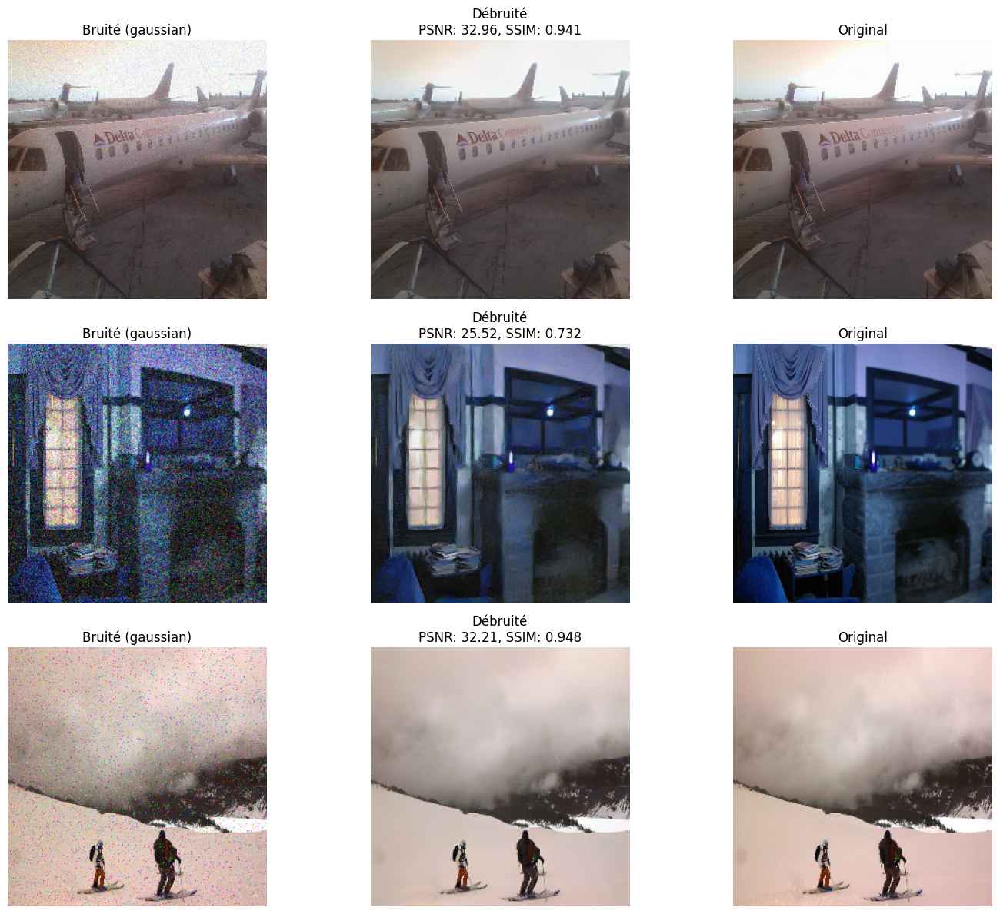

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


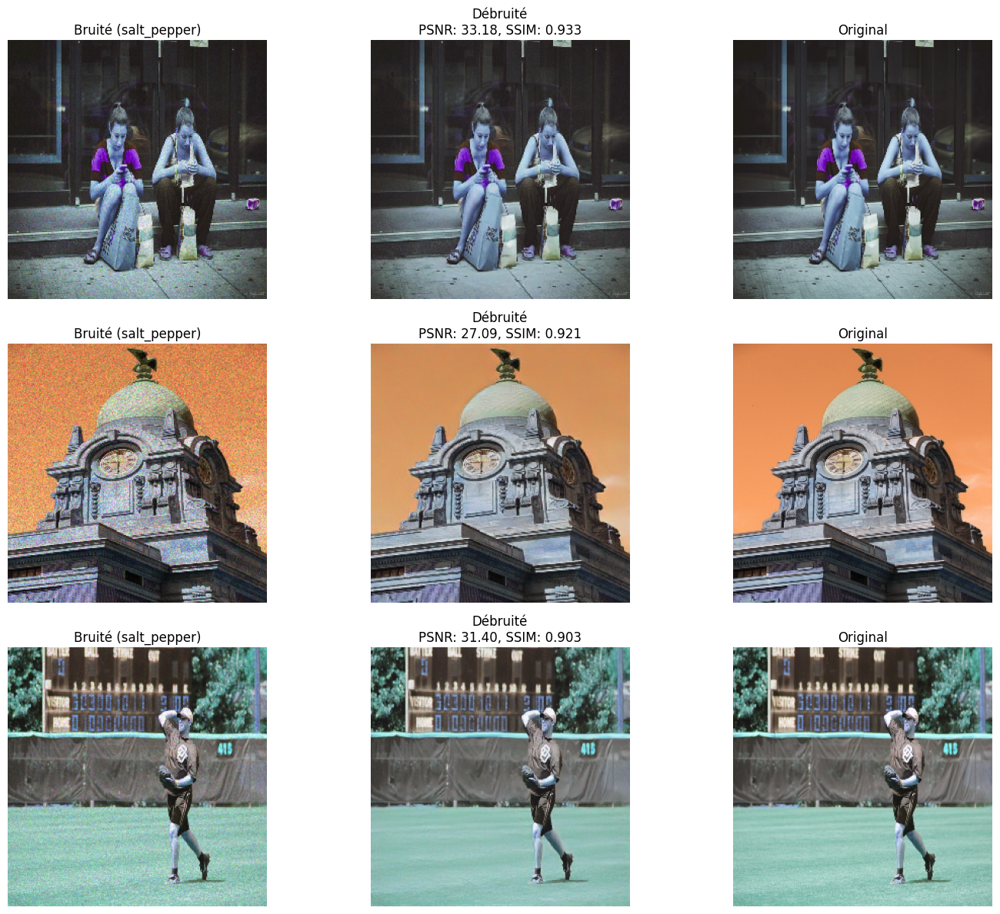

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


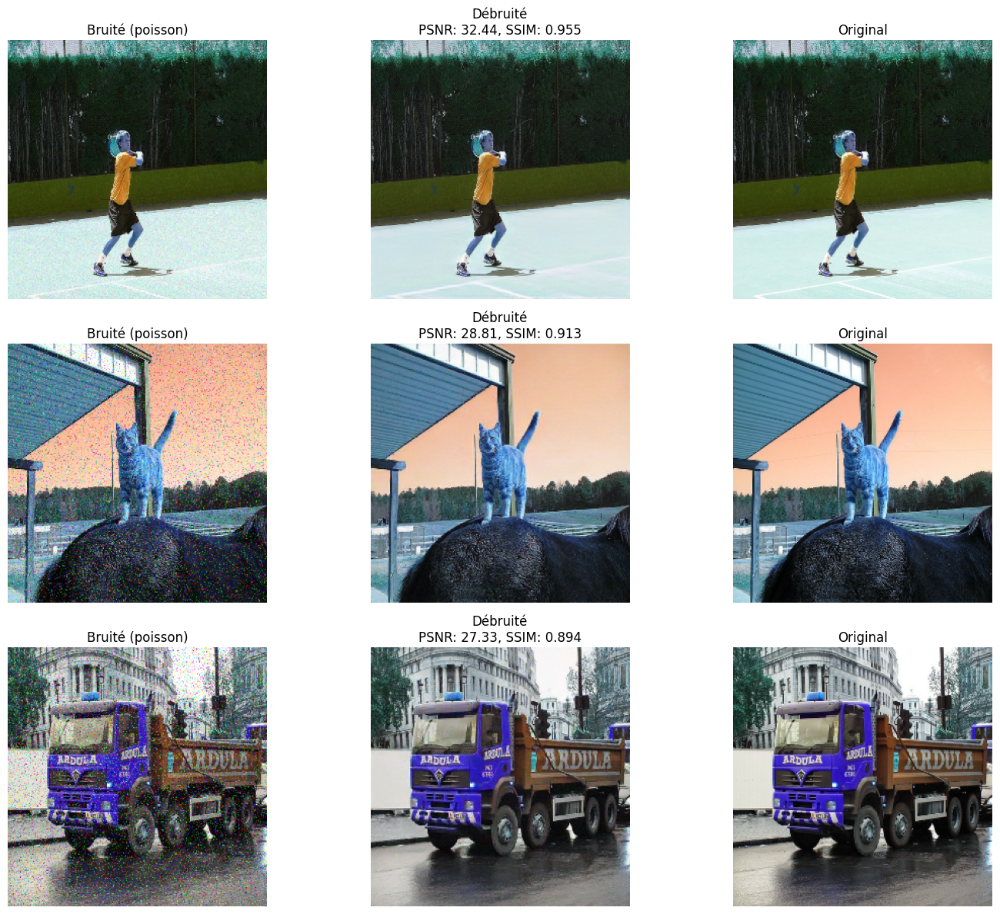

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


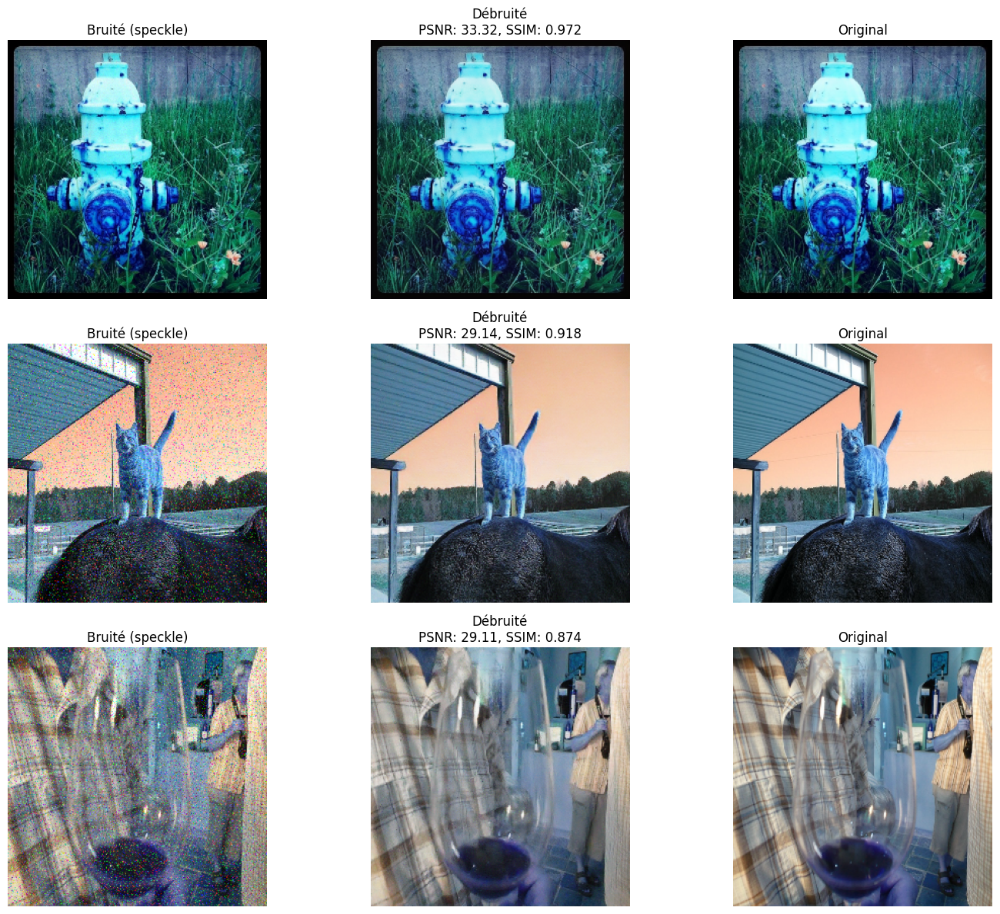

In [ ]:
def plot_noise_comparison(noise_type='gaussian', n_samples=3):
    # Sélection d'images avec le type de bruit spécifié
    idx = [i for i, info in enumerate(noise_info) if info[0] == noise_type]
    if len(idx) == 0:
        print(f"Aucune image trouvée pour le bruit '{noise_type}'")
        return
    n_samples = min(n_samples, len(idx))
    samples = np.random.choice(idx, size=n_samples, replace=False)
    
    plt.figure(figsize=(15, 4 * n_samples))
    for i, sample_idx in enumerate(samples):
        # Récupération des données
        noisy = X_noisy[sample_idx].astype(np.float32)
        clean = X_clean[sample_idx].astype(np.float32)
        

        pred = model.predict(noisy[np.newaxis, ...])[0].astype(np.float32)
        
        # Calcul des métriques (forcer float32)
        psnr_val = tf.image.psnr(clean, pred, max_val=1.0).numpy()
        ssim_val = tf.image.ssim(clean, pred, max_val=1.0).numpy()
        
        # Affichage
        plt.subplot(n_samples, 3, i*3+1)
        plt.imshow(np.clip(noisy, 0, 1))
        plt.title(f"Bruité ({noise_type})")
        plt.axis('off')
        
        plt.subplot(n_samples, 3, i*3+2)
        plt.imshow(np.clip(pred, 0, 1))
        plt.title(f"Débruité\nPSNR: {psnr_val:.2f}, SSIM: {ssim_val:.3f}")
        plt.axis('off')
        
        plt.subplot(n_samples, 3, i*3+3)
        plt.imshow(np.clip(clean, 0, 1))
        plt.title("Original")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Génération des visualisations pour chaque type de bruit
for noise_type in NOISE_CONFIG.keys():
    plot_noise_comparison(noise_type=noise_type)

In [41]:
import glob

#### LOAD THE MODEL

model = tf.keras.models.load_model(
    "best_model.h5",
    custom_objects={
        'HybridPSNRSSIM': HybridPSNRSSIM,
        'NoiseAdaptiveLoss': NoiseAdaptiveLoss,
        'PSNR': PSNR,
        'SSIM': SSIM,
        'hybrid_loss': hybrid_loss,
        'SpatialAttention': SpatialAttention,  # Ajout de la couche custom
        'residual_block': residual_block,      # (optionnel si utilisé dans le modèle)
        'multi_scale_unet': multi_scale_unet   # (optionnel si utilisé dans le modèle)
    }
)

def add_noise(img, noise_type, noise_level):
    img = img.astype(np.float32)
    if noise_type == 'gaussian':
        mean = 0
        std = noise_level
        noise = np.random.normal(mean, std, img.shape)
        noisy = img + noise
        return np.clip(noisy, 0, 1)
    elif noise_type == 'salt_pepper':
        s_vs_p = 0.5
        amount = noise_level
        noisy = np.copy(img)
        # Salt
        num_salt = np.ceil(amount * img.size * s_vs_p)
        coords = [np.random.randint(0, i, int(num_salt)) for i in img.shape]
        noisy[tuple(coords)] = 1
        # Pepper
        num_pepper = np.ceil(amount * img.size * (1. - s_vs_p))
        coords = [np.random.randint(0, i, int(num_pepper)) for i in img.shape]
        noisy[tuple(coords)] = 0
        return noisy
    elif noise_type == 'poisson':
        vals = len(np.unique(img))
        vals = 2 ** np.ceil(np.log2(vals))
        noisy = np.random.poisson(img * vals) / float(vals)
        return np.clip(noisy, 0, 1)
    elif noise_type == 'speckle':
        noise = np.random.randn(*img.shape) * noise_level
        noisy = img + img * noise
        return np.clip(noisy, 0, 1)
    else:
        return img

def test_model_on_deposit(model, deposit_dir="notebooks/livrable2/tests_deposit", n_variants=3):
    if not os.path.exists(deposit_dir):
        os.mkdir(deposit_dir)
        return

    image_paths = glob.glob(os.path.join(deposit_dir, "*"))
    if not image_paths:
        print("Aucune image trouvée dans", deposit_dir)
        return

    for img_path in image_paths:
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        if img is None:
            print(f"Impossible de lire {img_path}")
            continue
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, IMG_SIZE) / 255.0
        img = img.astype(np.float32)
        for noise_type, config in NOISE_CONFIG.items():
            # 2 colonnes (noisy, denoised), n_variants lignes
            fig, axes = plt.subplots(n_variants, 2, figsize=(6, 2.5 * n_variants))
            if n_variants == 1:
                axes = np.expand_dims(axes, axis=0)
            for v in range(n_variants):
                # Choix du niveau de bruit
                if 'mean' in config and 'std' in config:
                    level = np.clip(np.random.normal(config['mean'], config['std']), *config['clip'])
                elif noise_type == 'poisson':
                    level = None
                else:
                    level = 0.1
                noisy = add_noise(img, noise_type, level if level is not None else 0.1)
                pred = model.predict(noisy[np.newaxis, ...])[0].astype(np.float32)
                psnr_val = tf.image.psnr(img, pred, max_val=1.0).numpy()
                ssim_val = tf.image.ssim(img, pred, max_val=1.0).numpy()
                # Noisy
                axes[v, 0].imshow(np.clip(noisy, 0, 1))
                axes[v, 0].set_title(f"Noisy\n{noise_type} Var {v+1}")
                axes[v, 0].axis('off')
                # Denoised
                axes[v, 1].imshow(np.clip(pred, 0, 1))
                axes[v, 1].set_title(f"Denoised\nPSNR:{psnr_val:.2f} SSIM:{ssim_val:.3f}")
                axes[v, 1].axis('off')
            plt.suptitle(f"{os.path.basename(img_path)} - {noise_type}", fontsize=14, y=1.02)
            plt.tight_layout()
            plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


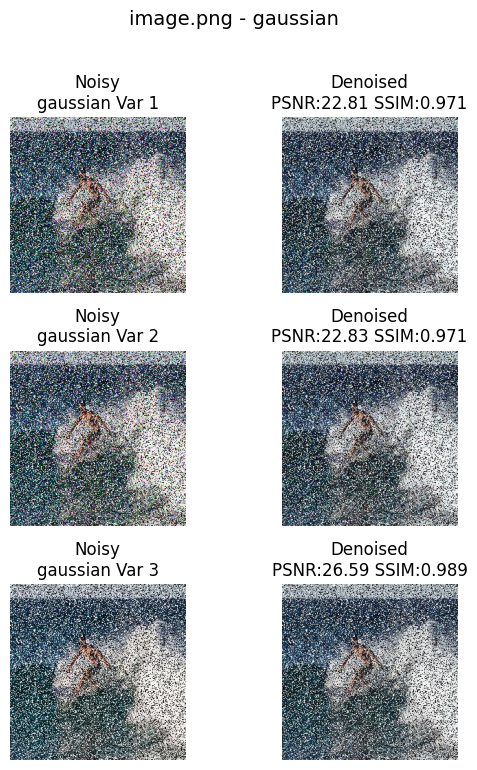

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


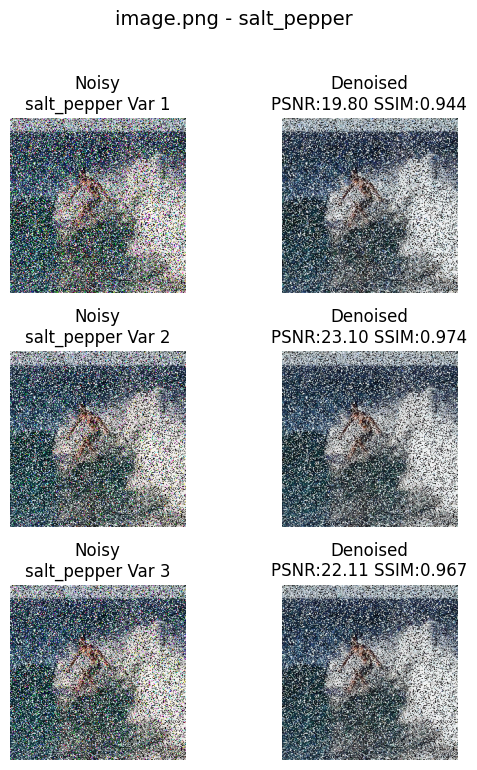

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


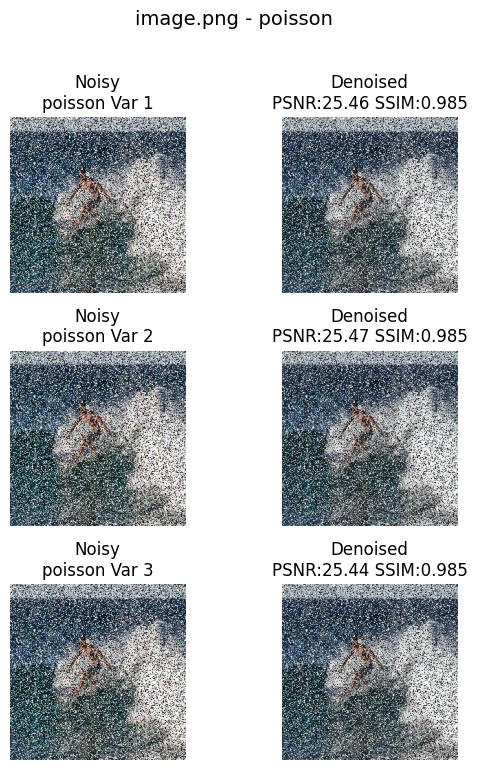

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


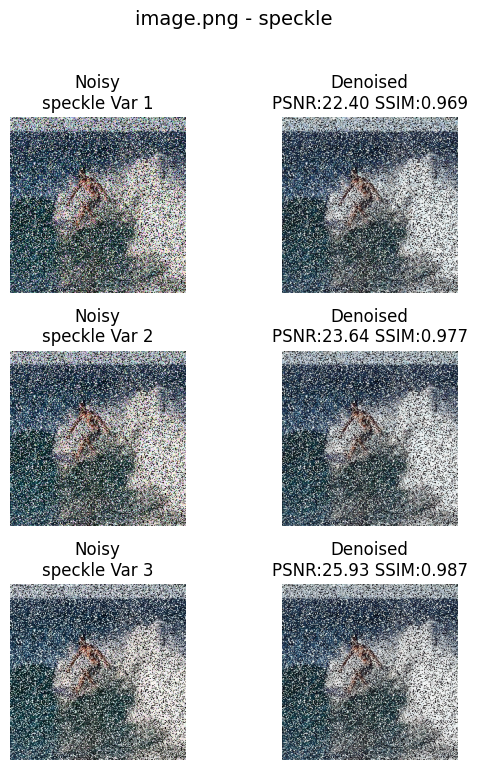

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


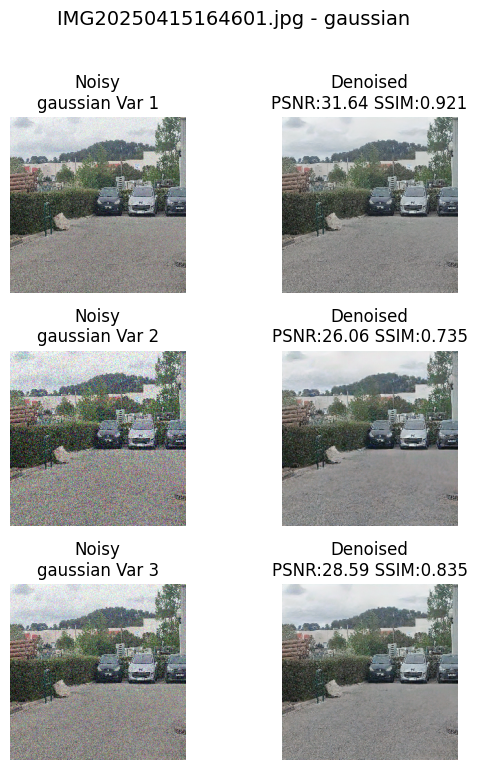

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


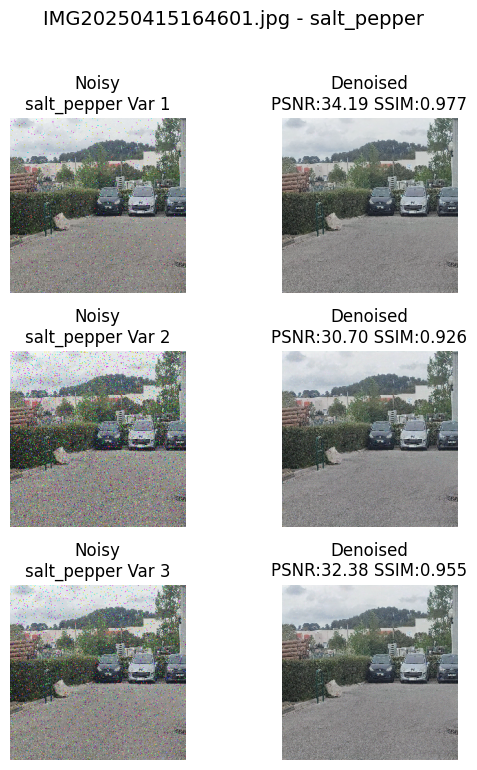

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


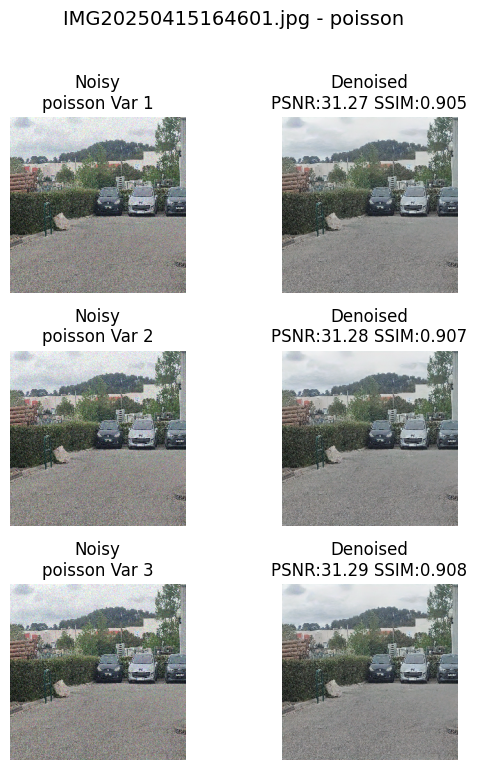

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


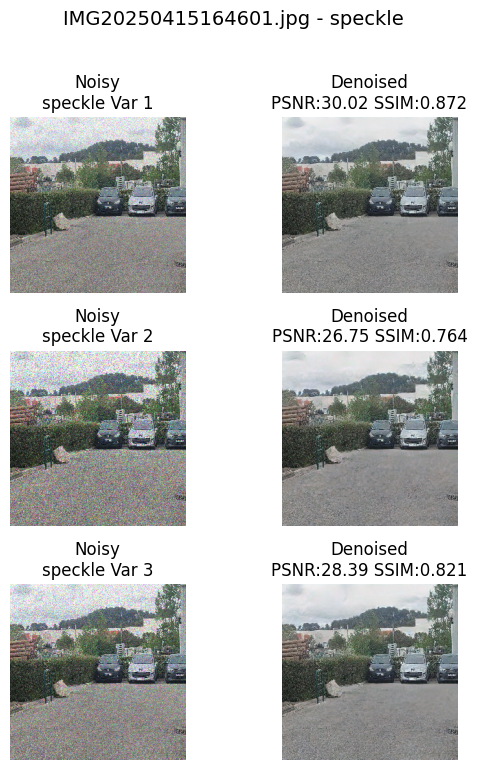

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


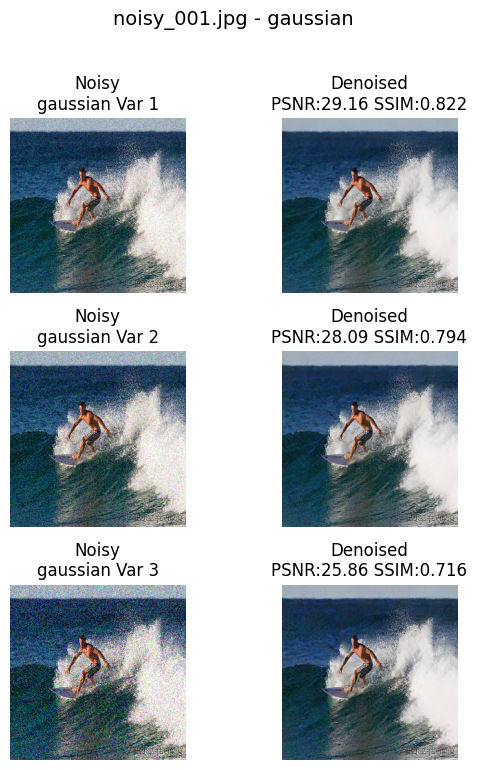

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


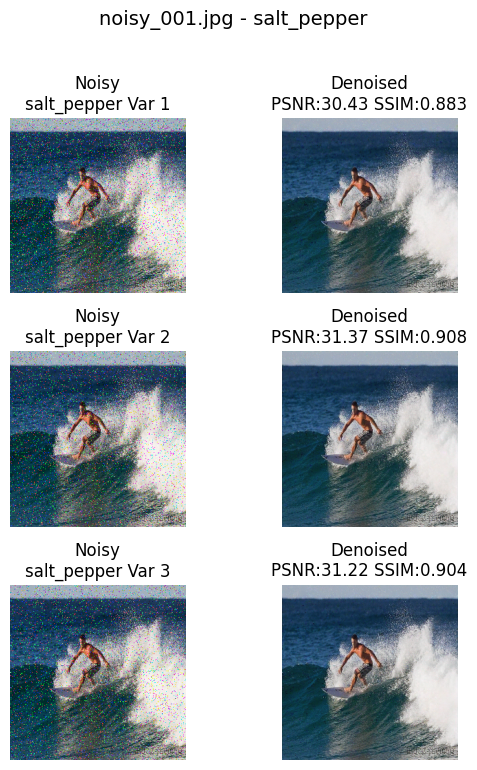

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


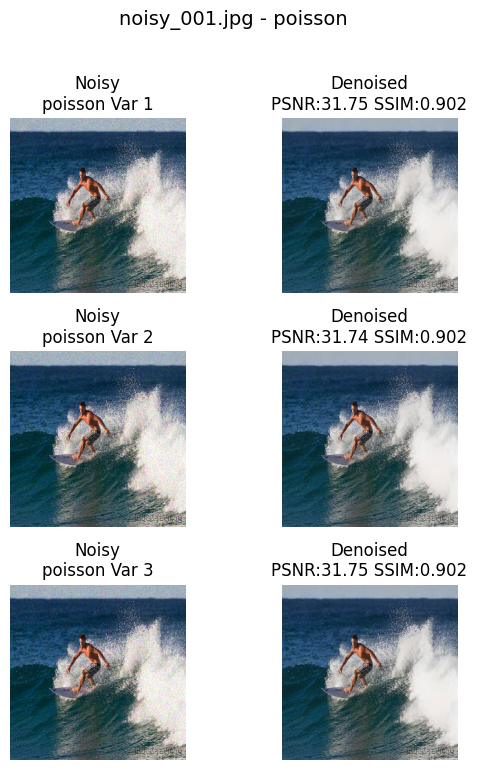

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


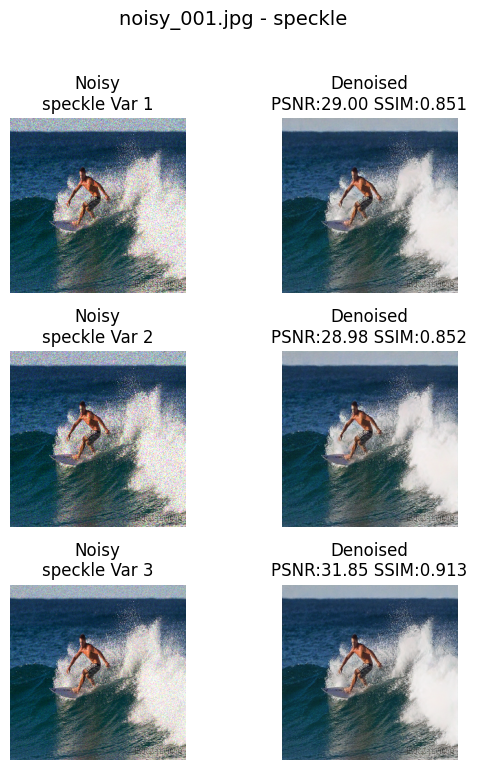

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


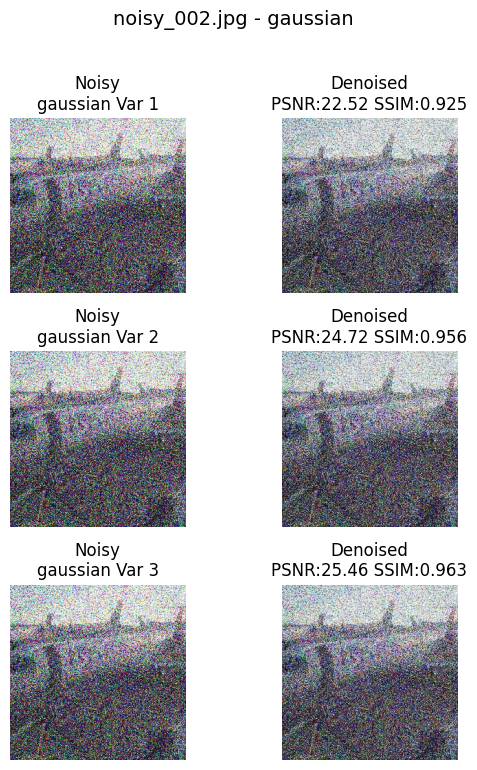

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


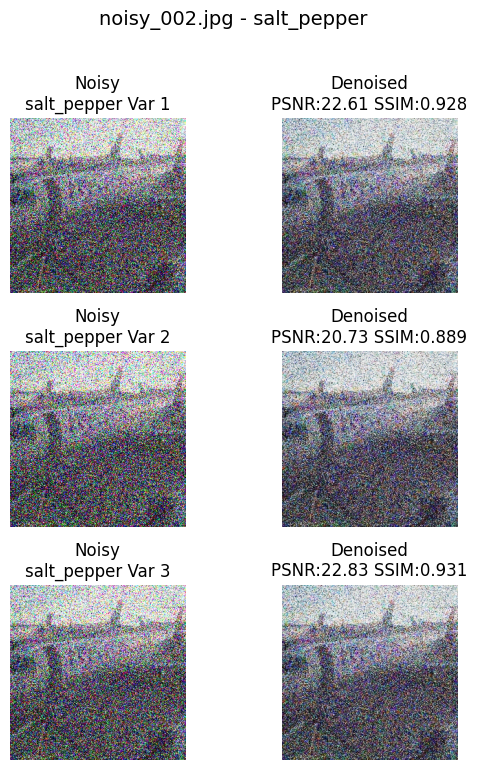

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


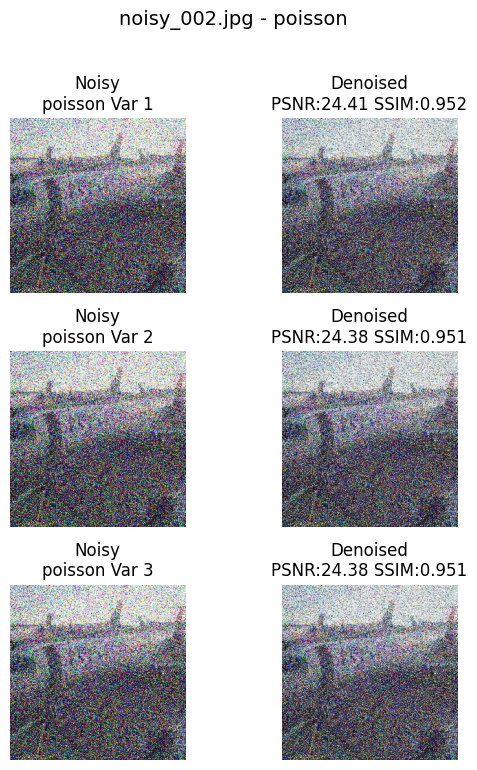

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


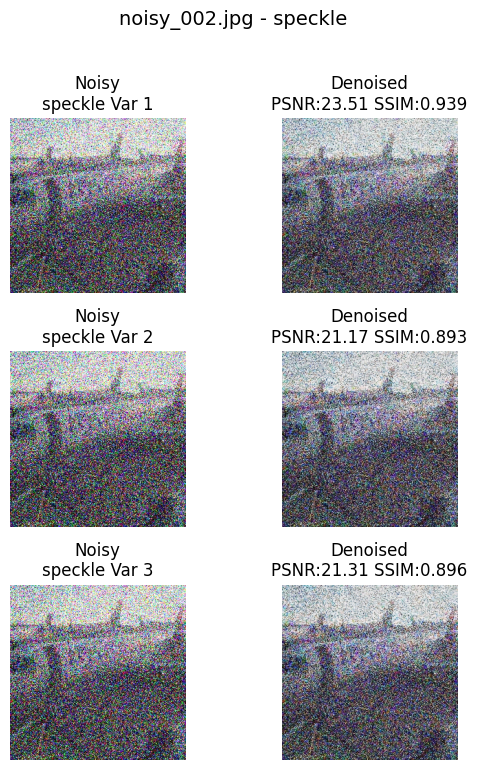

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


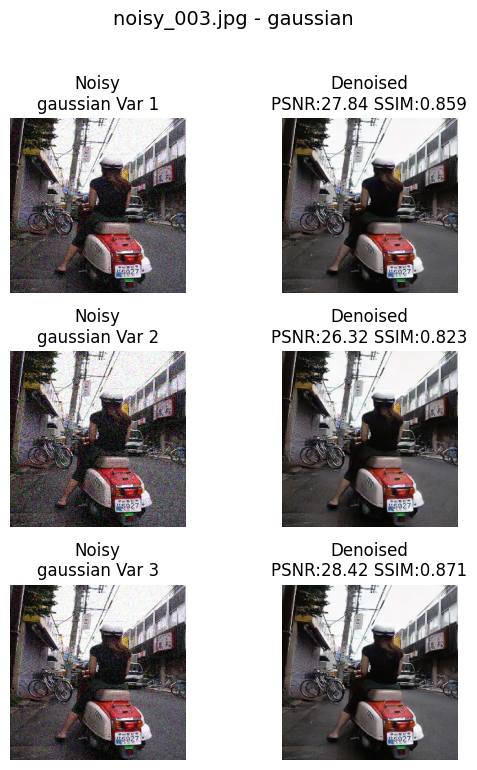

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


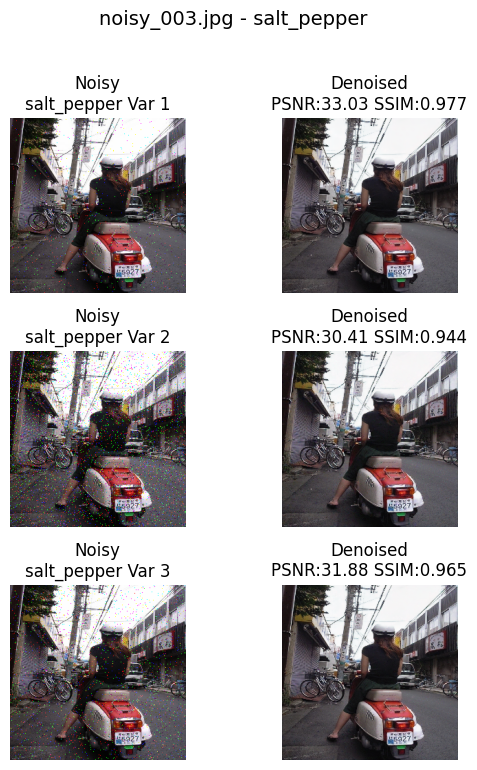

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


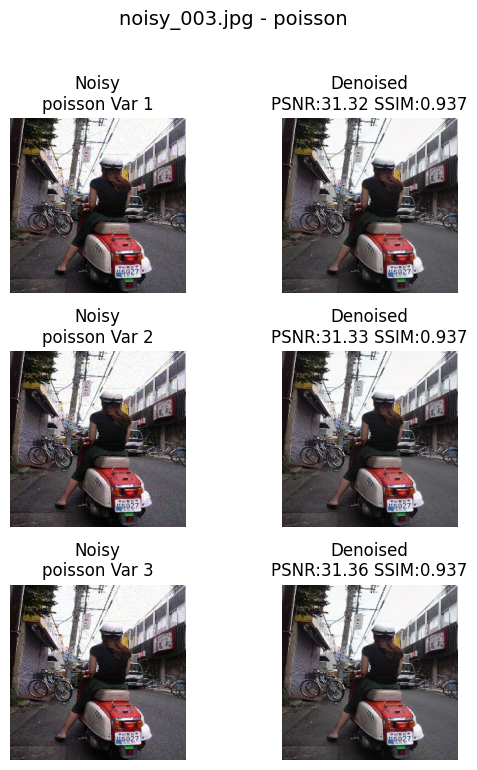

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


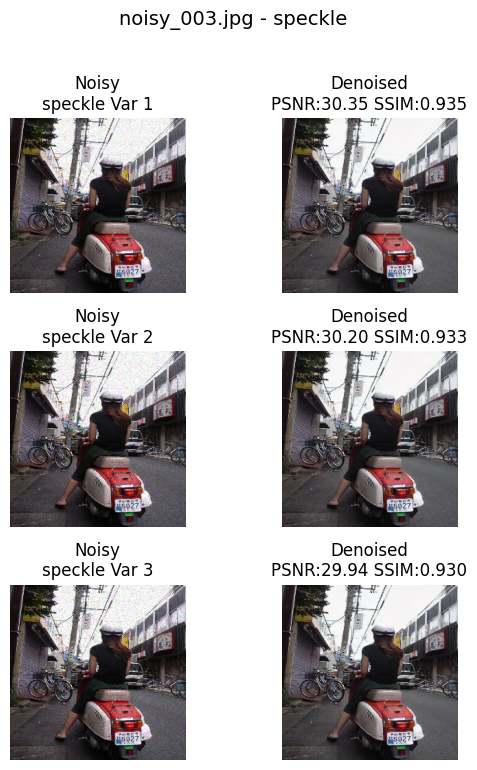

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


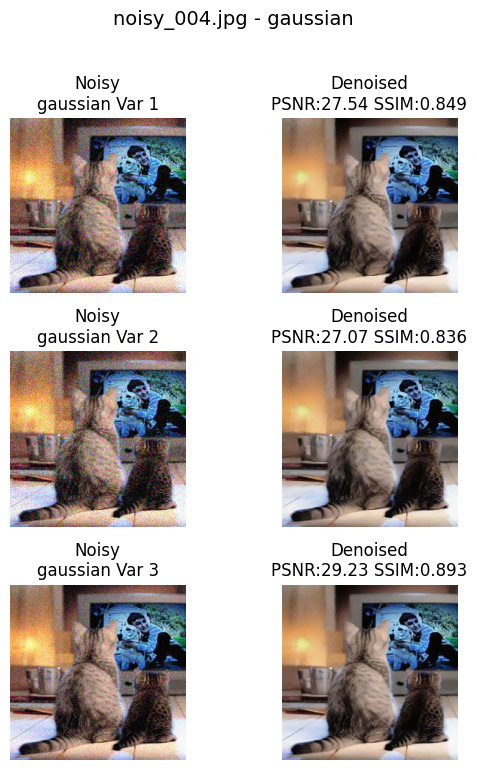

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


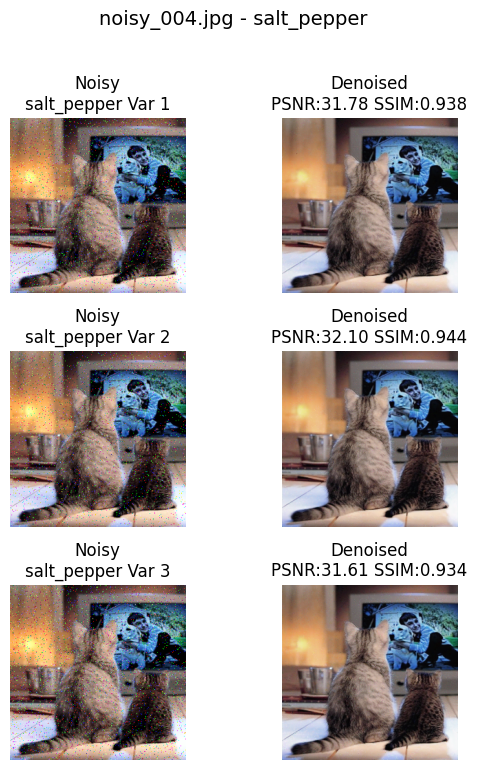

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


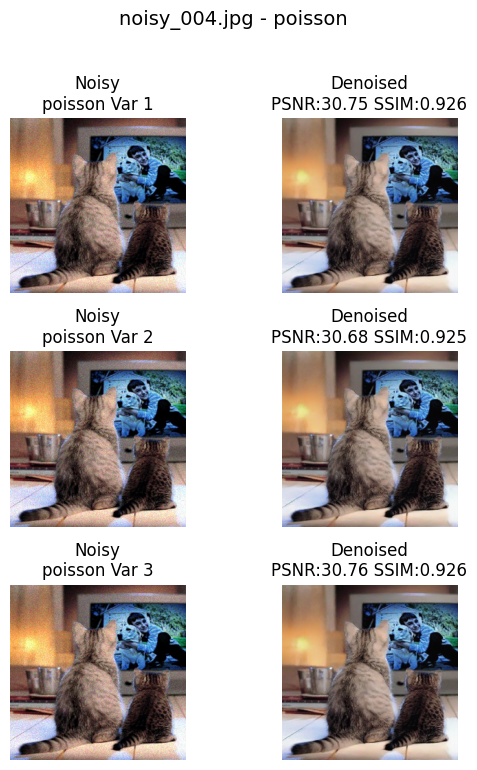

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


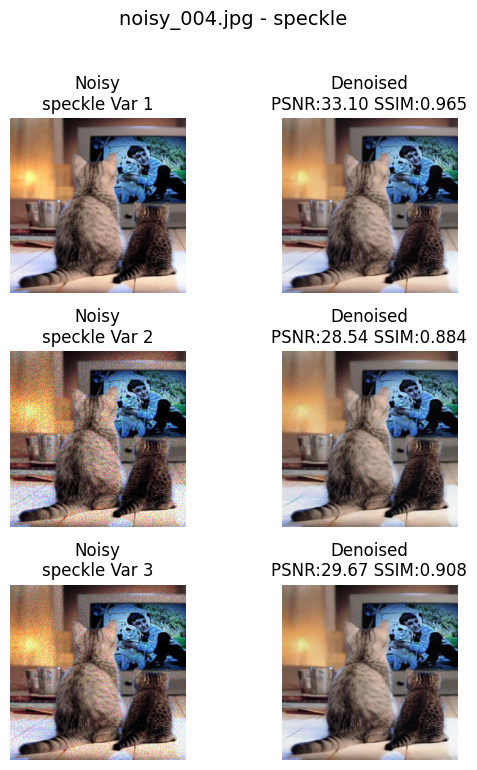

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


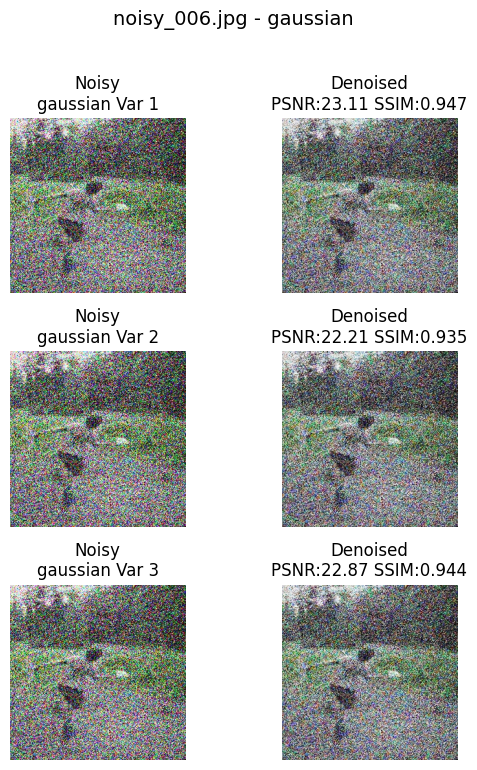

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


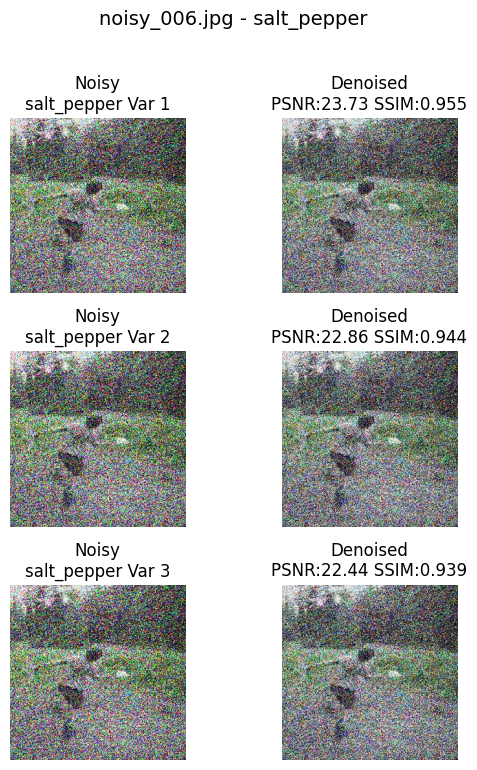

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


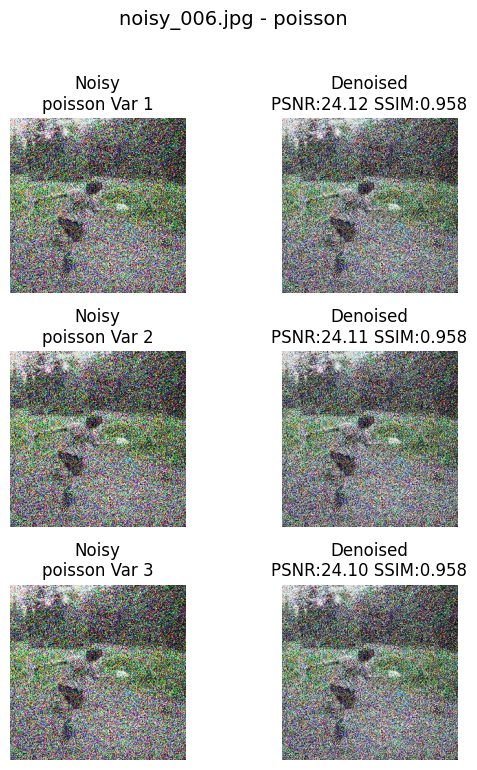

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


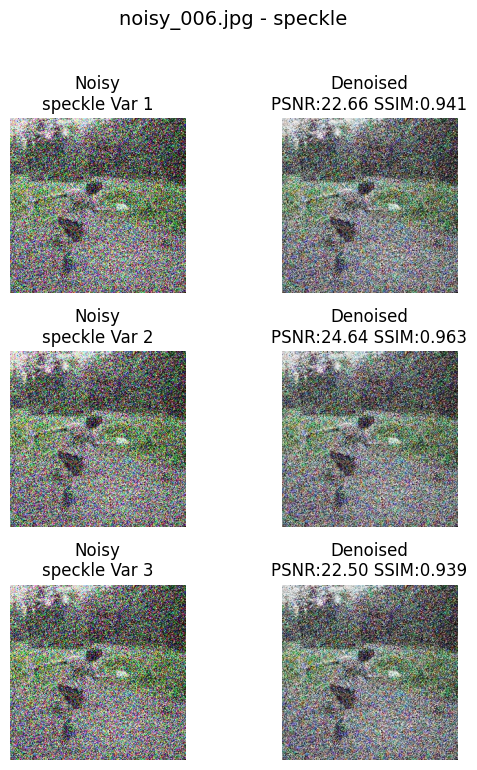

In [42]:
test_model_on_deposit(model, n_variants=3)


In [68]:
import glob

def denoise_images_in_folder(model, deposit_dir="notebooks/livrable2/tests_deposit"):
    image_paths = glob.glob(os.path.join(deposit_dir, "*"))
    if not image_paths:
        print("Aucune image trouvée dans", deposit_dir)
        return

    for img_path in image_paths:
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        if img is None:
            print(f"Impossible de lire {img_path}")
            continue
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_resized = cv2.resize(img_rgb, IMG_SIZE) / 255.0
        img_resized = img_resized.astype(np.float32)
        pred = model.predict(img_resized[np.newaxis, ...])[0].astype(np.float32)
        # Affichage côte à côte
        fig, axes = plt.subplots(1, 2, figsize=(8, 4))
        axes[0].imshow(np.clip(img_resized, 0, 1))
        axes[0].set_title("Original")
        axes[0].axis('off')
        axes[1].imshow(np.clip(pred, 0, 1))
        axes[1].set_title("Denoised")
        axes[1].axis('off')

        # Affichage des métriques intéressantes
        psnr_val = tf.image.psnr(img_resized, pred, max_val=1.0).numpy()
        ssim_val = tf.image.ssim(img_resized, pred, max_val=1.0).numpy()
        axes[1].set_title(f"Denoised\nPSNR: {psnr_val:.2f}, SSIM: {ssim_val:.3f}")
        axes[1].axis('off')
        plt.suptitle(os.path.basename(img_path), fontsize=14, y=1.02)
        plt.tight_layout()
        plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


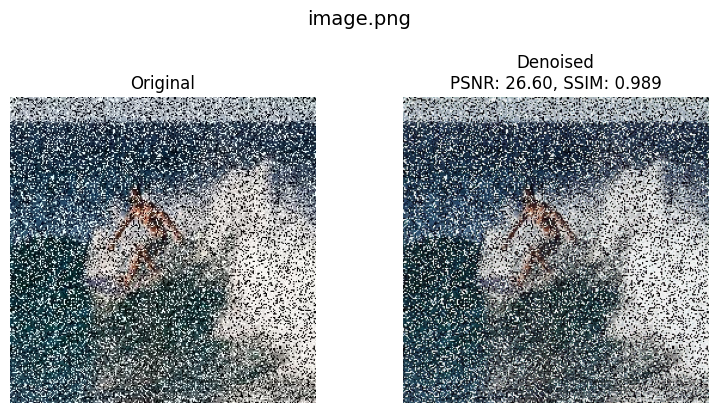

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


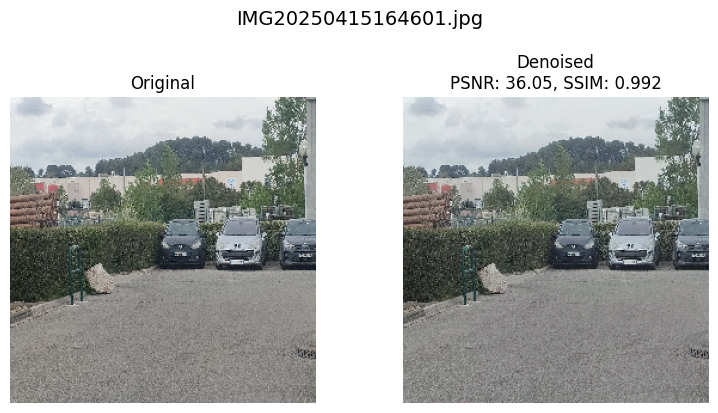

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


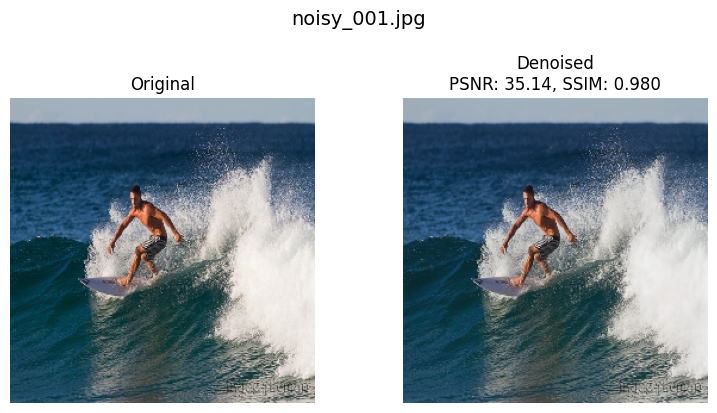

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


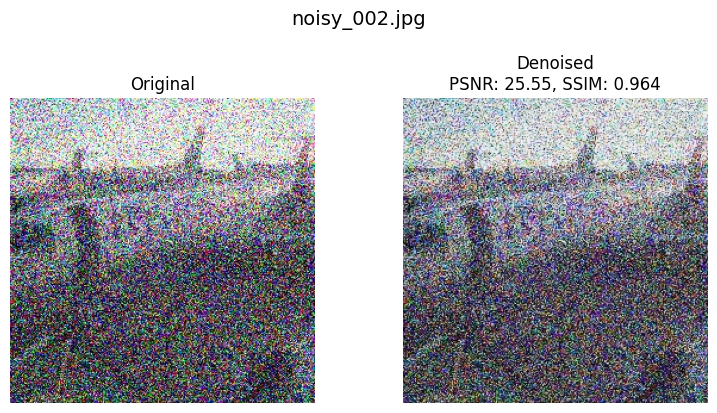

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


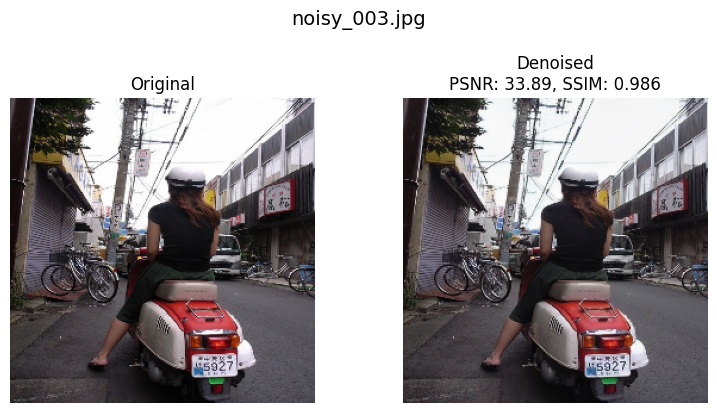

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


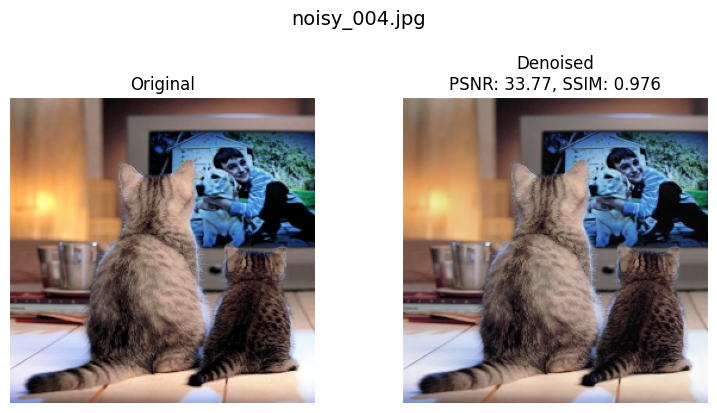

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


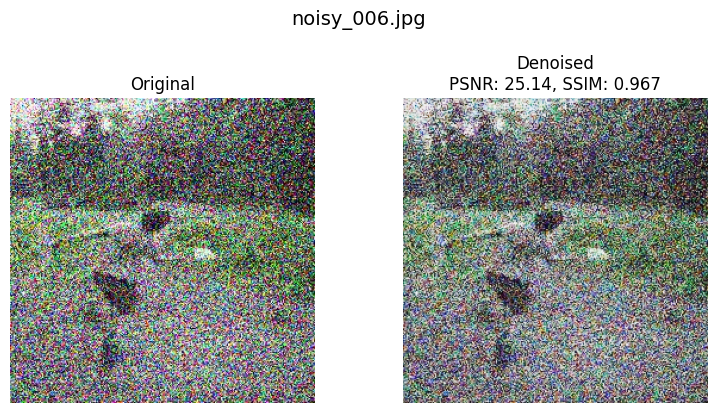

In [69]:

denoise_images_in_folder(model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━

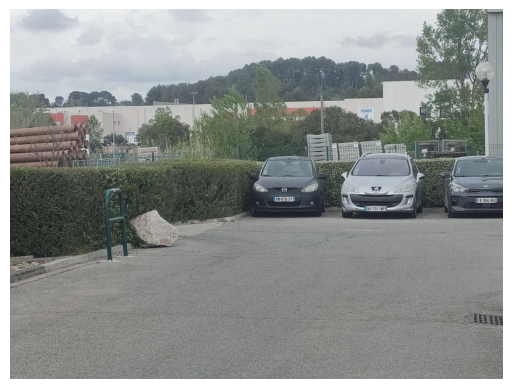

Image enregistrée à : notebooks/livrable2/tests_deposit/tests_processed/processed_image.jpg


In [46]:
import math

def process_image_by_patches(model, image, patch_size=(256, 256), overlap=32):
    """
    Traite une image de toute taille en la divisant en patchs, puis reconstruit l'image complète.
    
    Args:
        model: modèle de débruitage (ou autre) prenant des images de taille patch_size.
        image: np.ndarray, image d'entrée (H, W, C) en float32, valeurs [0,1].
        patch_size: tuple (h, w), taille des patchs à traiter.
        overlap: int, nombre de pixels de chevauchement entre patchs.
        
    Returns:
        np.ndarray: image reconstruite de la même taille que l'entrée.
    """
    h, w, c = image.shape
    ph, pw = patch_size

    # Calcul du nombre de patchs nécessaires
    n_patches_h = math.ceil((h - overlap) / (ph - overlap))
    n_patches_w = math.ceil((w - overlap) / (pw - overlap))

    # Initialisation de la sortie et du masque de normalisation
    output = np.zeros((h, w, c), dtype=np.float32)
    norm_mask = np.zeros((h, w, c), dtype=np.float32)

    for i in range(n_patches_h):
        for j in range(n_patches_w):
            y1 = i * (ph - overlap)
            x1 = j * (pw - overlap)
            y2 = min(y1 + ph, h)
            x2 = min(x1 + pw, w)
            y1 = max(0, y2 - ph)
            x1 = max(0, x2 - pw)

            patch = image[y1:y2, x1:x2, :]
            # Si le patch n'est pas de la bonne taille, on le complète par du padding
            pad_h = ph - patch.shape[0]
            pad_w = pw - patch.shape[1]
            if pad_h > 0 or pad_w > 0:
                patch = np.pad(patch, ((0, pad_h), (0, pad_w), (0, 0)), mode='reflect')

            # Prédiction sur le patch
            pred_patch = model.predict(patch[np.newaxis, ...])[0]
            # On enlève le padding si besoin
            pred_patch = pred_patch[:patch.shape[0], :patch.shape[1], :]

            # Ajout du patch à la sortie
            output[y1:y2, x1:x2, :] += pred_patch
            norm_mask[y1:y2, x1:x2, :] += 1.0

    # Normalisation pour gérer les zones de chevauchement
    output = output / np.maximum(norm_mask, 1e-8)
    output = np.clip(output, 0, 1)
    return output

img = cv2.imread("notebooks/livrable2/tests_deposit/IMG20250415164601.jpg", cv2.IMREAD_COLOR)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) / 255.0
result = process_image_by_patches(model, img, patch_size=(256,256), overlap=32)
plt.imshow(result)
plt.axis('off')
plt.show()

## Create a destination folder and save the output image
output_dir = "notebooks/livrable2/tests_deposit/tests_processed"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
output_path = os.path.join(output_dir, "processed_image.jpg")
result = cv2.cvtColor(result, cv2.COLOR_RGB2BGR)  # Convertir en BGR pour OpenCV
cv2.imwrite(output_path, (result * 255).astype(np.uint8))
print(f"Image enregistrée à : {output_path}")

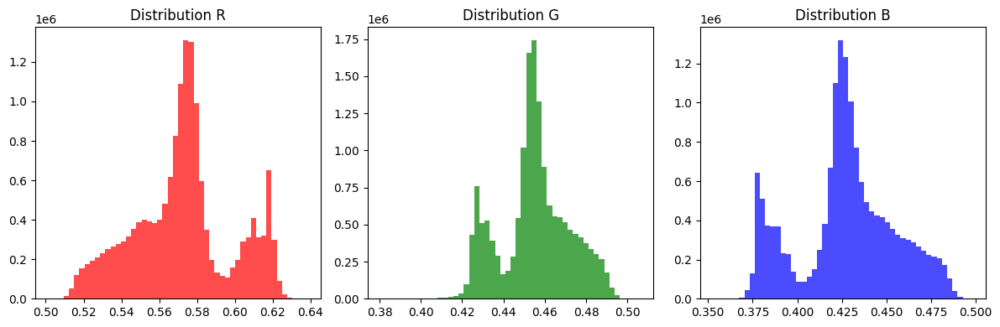

Min/max par canal : [0.5012206  0.38049048 0.35293108] [0.63865954 0.5063681  0.4984618 ]
Moyenne par canal : [0.52193624 0.4843047  0.4710447 ]


In [24]:
plt.figure(figsize=(12,4))
for i, color in enumerate(['R', 'G', 'B']):
    plt.subplot(1,3,i+1)
    plt.hist(result[...,i].flatten(), bins=50, color=color.lower(), alpha=0.7)
    plt.title(f'Distribution {color}')
plt.tight_layout()
plt.show()

# Vérification des stats
print("Min/max par canal :", result.min(axis=(0,1)), result.max(axis=(0,1)))
print("Moyenne par canal :", result.mean(axis=(0,1)))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


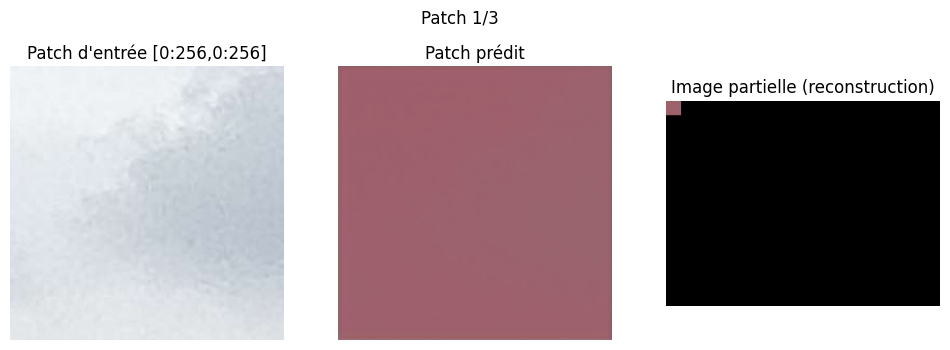

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


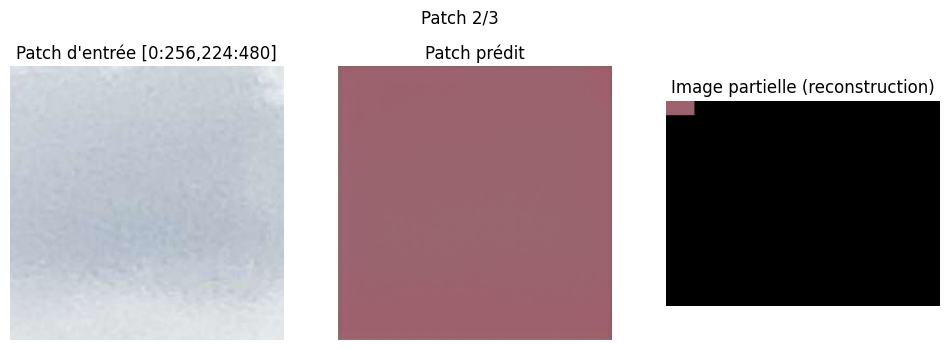

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


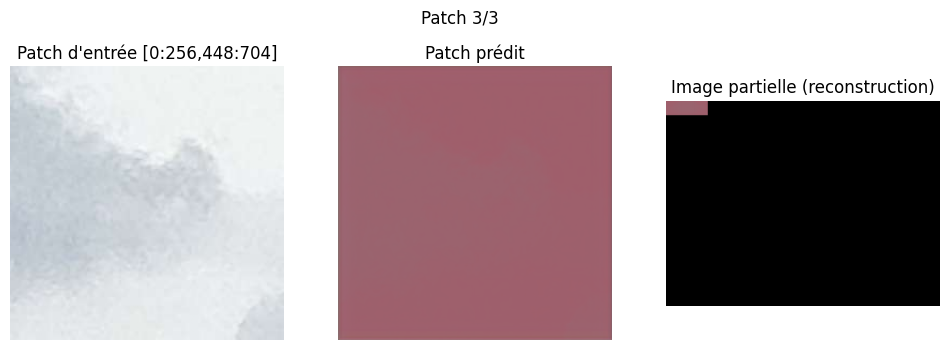

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━

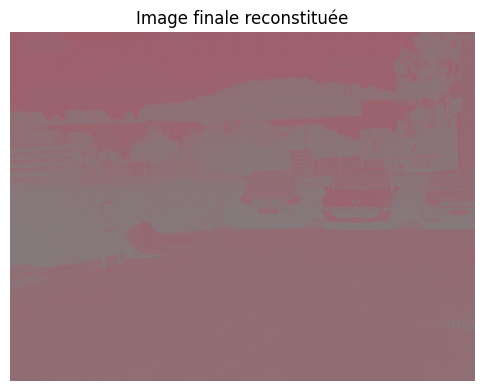

In [25]:
import math

def debug_process_image_by_patches(model, image, patch_size=(256, 256), overlap=32, force_rgb=True, debug_steps=True, max_patches=3):
    """
    Version debug : affiche les étapes du traitement par patchs.
    """
    image = image.astype(np.float32)
    if image.max() > 1.1:
        image = image / 255.0
    if force_rgb:
        if image.shape[-1] == 1:
            image = np.repeat(image, 3, axis=-1)
        elif image.shape[-1] == 4:
            image = image[..., :3]
    h, w, c = image.shape
    ph, pw = patch_size

    n_patches_h = math.ceil((h - overlap) / (ph - overlap))
    n_patches_w = math.ceil((w - overlap) / (pw - overlap))

    output = np.zeros((h, w, c), dtype=np.float32)
    norm_mask = np.zeros((h, w), dtype=np.float32)  # 2D mask

    patch_count = 0
    for i in range(n_patches_h):
        for j in range(n_patches_w):
            y1 = i * (ph - overlap)
            x1 = j * (pw - overlap)
            y2 = min(y1 + ph, h)
            x2 = min(x1 + pw, w)
            y1 = max(0, y2 - ph)
            x1 = max(0, x2 - pw)

            patch = image[y1:y2, x1:x2, :]
            pad_h = ph - patch.shape[0]
            pad_w = pw - patch.shape[1]
            if pad_h > 0 or pad_w > 0:
                patch = np.pad(patch, ((0, pad_h), (0, pad_w), (0, 0)), mode='reflect')

            pred_patch = model.predict(patch[np.newaxis, ...])[0].astype(np.float32)
            pred_patch = pred_patch[:patch.shape[0], :patch.shape[1], :]

            if pred_patch.shape[-1] == 1:
                pred_patch = np.repeat(pred_patch, 3, axis=-1)
            elif pred_patch.shape[-1] == 4:
                pred_patch = pred_patch[..., :3]

            output[y1:y2, x1:x2, :] += pred_patch
            norm_mask[y1:y2, x1:x2] += 1.0  # 2D mask

            # DEBUG : Affichage des patchs et de la reconstruction partielle
            if debug_steps and patch_count < max_patches:
                fig, axes = plt.subplots(1, 3, figsize=(12, 4))
                axes[0].imshow(np.clip(patch, 0, 1))
                axes[0].set_title(f"Patch d'entrée [{y1}:{y2},{x1}:{x2}]")
                axes[0].axis('off')
                axes[1].imshow(np.clip(pred_patch, 0, 1))
                axes[1].set_title("Patch prédit")
                axes[1].axis('off')
                # Affichage de la zone de sortie en cours de remplissage
                temp_out = output.copy()
                temp_out = temp_out / np.clip(norm_mask[..., None], 1e-6, None)
                axes[2].imshow(np.clip(temp_out, 0, 1))
                axes[2].set_title("Image partielle (reconstruction)")
                axes[2].axis('off')
                plt.suptitle(f"Patch {patch_count+1}/{max_patches}")
                plt.show()
                patch_count += 1

    norm_mask = np.clip(norm_mask, 1e-6, None)
    output = output / norm_mask[..., None]  # broadcast 2D mask to 3D
    output = np.clip(output, 0, 1)

    # DEBUG : Affichage de l'image finale
    plt.figure(figsize=(6, 6))
    plt.imshow(output)
    plt.title("Image finale reconstituée")
    plt.axis('off')
    plt.show()

    return output

# Test debug sur une image
img = cv2.imread("notebooks/livrable2/tests_deposit/IMG20250415164601.jpg", cv2.IMREAD_COLOR)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) / 255.0
result = debug_process_image_by_patches(model, img, patch_size=(256,256), overlap=32, debug_steps=True, max_patches=3)